In [305]:
import tensorflow as tf
from tensorflow.keras import Sequential
from tensorflow.keras.layers import Activation, Dense, Flatten, Reshape, Input, BatchNormalization
from tensorflow.keras.optimizers import Adam, Nadam
from tensorflow.keras.callbacks import EarlyStopping, ReduceLROnPlateau, ModelCheckpoint
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import style
from sklearn.preprocessing import MinMaxScaler
from sklearn import metrics
from fuzzy_layer import FuzzyLayer
import seaborn as sns
import plotly.graph_objects as go
from keras import backend as K
from Reset_Create_y import create_target_data
from Not_test_v2 import nor_std, nor_std_inverse
from RBF_Disassemble import feature_select, delt_unimportant, select_unimportant, important, split_train_test
import os

plt.style.use("ggplot")

# DataPrepare

In [177]:
#DataFrame
train_df = pd.read_csv('Month_1.csv')
train_df.rename(columns={'店名':'name'}, inplace=True)
target_df = pd.read_csv('y_107.csv')
target_df = create_target_data(target_df)
drop_col = target_df.columns[1:14]

train_df = target_df.merge(train_df, on=['name']).drop(columns=drop_col)

# test_df = [pd.read_csv(name) for name in test_csv_file]
test_df = pd.read_csv('Month_1.csv')
test_df.rename(columns={'店名':'name'}, inplace=True)
target_108_df = pd.read_csv('y_108.csv')
test_df = target_108_df.merge(test_df, on=['name']).drop(columns=drop_col)

#Real Value on 108_Target
target_108_real_df = pd.read_csv('108_store_i_new.csv')

# Scale

In [126]:
target_scaler = MinMaxScaler()
target_scaler.fit(target_df.iloc[:, 1:-1])
target_scale_df = pd.DataFrame(target_scaler.fit_transform(target_df.iloc[:, 1:-1]), columns=target_df.iloc[:, 1:-1].columns.tolist())

In [136]:
df_mean = pd.DataFrame(nor_std(target_df['mean'], target_df['mean']), columns=['mean'])
target_scale_df = pd.concat([target_scale_df, df_mean], axis=1)

# Model Function

In [306]:
def create_nn_model(df):
    model = Sequential()
    model.add(FuzzyLayer(fuzzy_size=3, input_shape=(df.shape[1],)))
    model.add(Reshape((df.shape[1] * 3,)))
    model.add(Dense(256, activation='relu', kernel_regularizer='l2'))
    model.add(Dense(128, activation='relu', kernel_regularizer='l2'))
    model.add(Dense(64, activation='relu', kernel_regularizer='l2'))
    model.add(tf.keras.layers.Dropout(0.8))
    model.add(Dense(1))

    INIT_LR = 1e-3
    opt = Nadam(lr=INIT_LR, decay=INIT_LR / 2000)
    model.compile(optimizer=opt, loss='mse')

    return model

learning_rate_reduction = ReduceLROnPlateau(monitor='val_loss',
                                                patience=7,
                                                factor=0.5,
                                                min_lr=0.00001)

callbacks = [learning_rate_reduction]


def create_new_model(train_X, target):
    train, test = split_train_test(train_X)

    select_feature = train_X.shape[1]

    model = Sequential()
    model.add(FuzzyLayer(fuzzy_size=3, input_shape=(select_feature,)))
    model.add(Reshape((select_feature * 3,)))
    model.add(Dense(256, activation='relu', kernel_regularizer='l2'))
    model.add(Dense(128, activation='relu', kernel_regularizer='l2'))
    model.add(Dense(64, activation='relu', kernel_regularizer='l2'))
    model.add(tf.keras.layers.Dropout(0.5))
    model.add(Dense(1))

    INIT_LR = 1e-3
    opt = Adam(lr=INIT_LR, decay=INIT_LR / 2000)
    model.compile(optimizer=opt, loss='mse')
    learning_rate_reduction = ReduceLROnPlateau(monitor='val_loss',
                                                patience=7,
                                                factor=0.5,
                                                min_lr=0.00001)

    callbacks = [learning_rate_reduction]

    history = model.fit(train, target, epochs=epoch, validation_split=0.15, callbacks=callbacks, verbose=0)

    get_fuzzy_layer_output = K.function([model.layers[0].input],[model.layers[1].output])
    layer_output = get_fuzzy_layer_output([test.astype('float32')])[0]
    #         feature1 = np.hstack(layer_output.reshape(len(testX),108*3,1))
    feature = layer_output.reshape(len(test), select_feature * 3)

    return model, feature, history

# Model

In [179]:
threshold = np.arange(0.1, 0.5, 0.025)
epoch = 100

important_feature_df = pd.DataFrame()

important_feature = []
feature_set = []

thre = 0.175
month_pred = []

for i in range(50):
    # for col_name in target_scale_df.columns.tolist()[:-1]:
    for col_name in target_df.columns.tolist()[1:-1]:
        train_df = pd.read_csv(col_name + '.csv')
        train_df.rename(columns={'店名': 'name'}, inplace=True)
        scaler = MinMaxScaler()
        scaler.fit(train_df.iloc[:, 2:])
        train_df = target_df.merge(train_df, on=['name']).drop(columns=drop_col)
        train_df_scale = pd.DataFrame(scaler.fit_transform(train_df.iloc[:, 2:]),
                                      columns=train_df.iloc[:, 2:].columns)

        model, feature, history = create_new_model(train_df_scale, target_scale_df)
        fe, unimport, feature_std = feature_select(feature, train_df_scale, thre)
        delt = delt_unimportant(unimport)
        delete = select_unimportant(delt)
        delete = set(select_unimportant(delt_unimportant(unimport)))
        important = train_df_scale.drop(columns=delete).columns.tolist()
        feature_set.append('{},'.format(sorted(important)))
        print(col_name)
        print(important)

Month_2
['機車', '汽車', '角間', '住戶數', '100公尺內cvs競爭店', '日間人口_200', '夜間人口_100', '夜間人口_150', '戶口數_100', '戶口數_150', '主要客群_150', '7-11店鋪數_50', '7-11店鋪數_100', '7-11日商_50', '7-11日商_150', '7-11日商_200', 'FM日商_150', '住宅_佔比', '通勤_佔比', '文教_佔比', '觀光_佔比', '開幾月']


KeyboardInterrupt: 

In [275]:
important_feature = []
important_feature.append([['住宅_佔比', '7-11日商_200', '觀光_佔比', '100公尺內cvs競爭店', '7-11店鋪數_50', '商業_佔比', '7-11日商_50', '角間', '7-11日商_150', '汽車']])
important_feature.append(['觀光_佔比', '7-11日商_200', '通勤_佔比', '7-11日商_50', '機車', '7-11店鋪數_50', '住宅_佔比', '男女比_200', '7-11店鋪數_100', '7-11日商_100'])
important_feature.append(['住宅_佔比', '觀光_佔比', '7-11日商_200', '角間', '機車', '開幾月', '7-11日商_100', '商業_佔比', '7-11日商_50', '通勤_佔比'])
important_feature.append(['觀光_佔比', '7-11店鋪數_50', '7-11日商_200', '機車', '住宅_佔比', '100公尺內cvs競爭店', '7-11日商_150', '通勤_佔比', '住戶數', '汽車'])
important_feature.append(['觀光_佔比', '7-11日商_200', '住宅_佔比', '機車', '7-11日商_50', '7-11日商_100', '通勤_佔比', '7-11店鋪數_50', '7-11店鋪數_100', '商業_佔比'])
important_feature.append(['觀光_佔比', '7-11日商_200', '住宅_佔比', '機車', '商業_佔比', '通勤_佔比', '住戶數', '7-11日商_100', '開幾月', '7-11店鋪數_50'])
important_feature.append(['觀光_佔比', '住宅_佔比', '通勤_佔比', '7-11日商_100', '7-11店鋪數_50', '7-11日商_200', '一面', '汽車', '機車', '開幾月'])
important_feature.append(['住宅_佔比', '7-11店鋪數_50', '機車', '汽車', '觀光_佔比', '7-11日商_50', '7-11店鋪數_100', '開幾月', '7-11日商_200', '商業_佔比'])
important_feature.append(['7-11日商_50', '住宅_佔比', '機車', '7-11日商_100', '通勤_佔比', '觀光_佔比', '7-11店鋪數_50', '7-11日商_200', '男女比_200', '開幾月'])
important_feature.append(['住宅_佔比', '觀光_佔比', '7-11日商_50', '通勤_佔比', '7-11日商_100', '男女比_200', '一面', '7-11日商_150', '角間', '7-11店鋪數_100'])
important_feature.append(['住宅_佔比', '一面', '機車', '觀光_佔比', '7-11日商_200', '角間', '7-11日商_150', '7-11店鋪數_100', '7-11日商_100', '開幾月'])
important_feature.append(['7-11日商_50', '觀光_佔比', '通勤_佔比', '住宅_佔比', '7-11日商_150', '商業_佔比', '開幾月', '汽車', '100公尺內cvs競爭店', '7-11日商_100'])
important_feature.append(['住宅_佔比', '7-11日商_200', '觀光_佔比', '7-11日商_150', '汽車', '100公尺內cvs競爭店', '7-11店鋪數_50', '7-11日商_100', '商業_佔比', '7-11日商_50'])

In [276]:
epoch=100
train_col = target_df.columns.tolist()[1:-1] + ['mean']

In [307]:
month_pred = []

for i, col_name in enumerate(train_col):
    train_df = pd.read_csv(col_name + '.csv')
    train_df.rename(columns={'店名': 'name'}, inplace=True)
    scaler = MinMaxScaler()
    scaler.fit(train_df.iloc[:, 2:])
    train_df = target_df.merge(train_df, on=['name']).drop(columns=drop_col)
    train_df_scale = pd.DataFrame(scaler.fit_transform(train_df.iloc[:, 2:]),
                                  columns=train_df.iloc[:, 2:].columns)
    test_df_scale = pd.DataFrame(scaler.fit_transform(test_df.iloc[:, 2:]),
                                 columns=train_df.iloc[:, 2:].columns)

    test_df = pd.read_csv(col_name + '.csv')
    test_df.rename(columns={'店名': 'name'}, inplace=True)
    test_df = target_108_df.merge(test_df, on=['name']).drop(columns=drop_col)
    test_df_scale = pd.DataFrame(scaler.fit_transform(test_df.iloc[:, 2:]),
                                 columns=train_df.iloc[:, 2:].columns)

    train = train_df_scale[important_feature[i]]
    test = test_df_scale[important_feature[i]]

    model = create_nn_model(train)
    history = model.fit(train, target_scale_df.iloc[:, i], 
                        epochs=epoch, 
                        validation_split=0.1, 
                        callbacks=callbacks, 
                        verbose=1)
    month_pred.append(model.predict(test))

    tf.keras.backend.clear_session()

Epoch 1/100
2/2 [==============================] - 0s 43ms/step - loss: 4.3936 - val_loss: 3.9020
Epoch 2/100
2/2 [==============================] - 0s 6ms/step - loss: 4.1066 - val_loss: 3.8776
Epoch 3/100
2/2 [==============================] - 0s 6ms/step - loss: 3.9816 - val_loss: 3.8268
Epoch 4/100
2/2 [==============================] - 0s 6ms/step - loss: 3.9168 - val_loss: 3.6861
Epoch 5/100
2/2 [==============================] - 0s 6ms/step - loss: 3.6655 - val_loss: 3.5842
Epoch 6/100
2/2 [==============================] - 0s 6ms/step - loss: 3.5659 - val_loss: 3.5107
Epoch 7/100
2/2 [==============================] - 0s 6ms/step - loss: 3.4606 - val_loss: 3.4325
Epoch 8/100
2/2 [==============================] - 0s 6ms/step - loss: 3.3544 - val_loss: 3.3488
Epoch 9/100
2/2 [==============================] - 0s 6ms/step - loss: 3.3225 - val_loss: 3.2916
Epoch 10/100
2/2 [==============================] - 0s 6ms/step - loss: 3.2091 - val_loss: 3.2163
Epoch 11/100
2/2 [==========

2/2 [==============================] - 0s 6ms/step - loss: 1.1968 - val_loss: 1.3215
Epoch 66/100
2/2 [==============================] - 0s 6ms/step - loss: 1.1877 - val_loss: 1.3393
Epoch 67/100
2/2 [==============================] - 0s 5ms/step - loss: 1.1725 - val_loss: 1.2995
Epoch 68/100
2/2 [==============================] - 0s 6ms/step - loss: 1.1637 - val_loss: 1.2585
Epoch 69/100
2/2 [==============================] - 0s 6ms/step - loss: 1.1464 - val_loss: 1.2998
Epoch 70/100
2/2 [==============================] - 0s 5ms/step - loss: 1.1459 - val_loss: 1.2541
Epoch 71/100
2/2 [==============================] - 0s 6ms/step - loss: 1.1261 - val_loss: 1.1859
Epoch 72/100
2/2 [==============================] - 0s 6ms/step - loss: 1.1000 - val_loss: 1.1665
Epoch 73/100
2/2 [==============================] - 0s 6ms/step - loss: 1.0779 - val_loss: 1.1524
Epoch 74/100
2/2 [==============================] - 0s 6ms/step - loss: 1.0668 - val_loss: 1.1261
Epoch 75/100
2/2 [===============

2/2 [==============================] - 0s 6ms/step - loss: 1.3711 - val_loss: 1.4589
Epoch 49/100
2/2 [==============================] - 0s 6ms/step - loss: 1.3471 - val_loss: 1.4178
Epoch 50/100
2/2 [==============================] - 0s 6ms/step - loss: 1.3326 - val_loss: 1.3952
Epoch 51/100
2/2 [==============================] - 0s 6ms/step - loss: 1.3044 - val_loss: 1.3711
Epoch 52/100
2/2 [==============================] - 0s 6ms/step - loss: 1.2793 - val_loss: 1.3420
Epoch 53/100
2/2 [==============================] - 0s 6ms/step - loss: 1.2532 - val_loss: 1.3351
Epoch 54/100
2/2 [==============================] - 0s 5ms/step - loss: 1.2264 - val_loss: 1.2613
Epoch 55/100
2/2 [==============================] - 0s 6ms/step - loss: 1.2447 - val_loss: 1.2831
Epoch 56/100
2/2 [==============================] - 0s 6ms/step - loss: 1.1966 - val_loss: 1.2210
Epoch 57/100
2/2 [==============================] - ETA: 0s - loss: 1.222 - 0s 6ms/step - loss: 1.2199 - val_loss: 1.2312
Epoch 58/

Epoch 31/100
2/2 [==============================] - 0s 6ms/step - loss: 2.2595 - val_loss: 2.3026
Epoch 32/100
2/2 [==============================] - 0s 6ms/step - loss: 2.2291 - val_loss: 2.2823
Epoch 33/100
2/2 [==============================] - 0s 6ms/step - loss: 2.2046 - val_loss: 2.3338
Epoch 34/100
2/2 [==============================] - 0s 6ms/step - loss: 2.1350 - val_loss: 2.2847
Epoch 35/100
2/2 [==============================] - 0s 6ms/step - loss: 2.1032 - val_loss: 2.2416
Epoch 36/100
2/2 [==============================] - 0s 6ms/step - loss: 2.0632 - val_loss: 2.1991
Epoch 37/100
2/2 [==============================] - 0s 6ms/step - loss: 2.0313 - val_loss: 2.1577
Epoch 38/100
2/2 [==============================] - 0s 6ms/step - loss: 1.9973 - val_loss: 2.1101
Epoch 39/100
2/2 [==============================] - 0s 6ms/step - loss: 1.9686 - val_loss: 2.0134
Epoch 40/100
2/2 [==============================] - 0s 6ms/step - loss: 1.9270 - val_loss: 1.9706
Epoch 41/100
2/2 [==

2/2 [==============================] - 0s 6ms/step - loss: 0.7872 - val_loss: 0.8337
Epoch 96/100
2/2 [==============================] - 0s 6ms/step - loss: 0.7719 - val_loss: 0.8269
Epoch 97/100
2/2 [==============================] - 0s 6ms/step - loss: 0.7538 - val_loss: 0.8229
Epoch 98/100
2/2 [==============================] - 0s 6ms/step - loss: 0.7560 - val_loss: 0.8020
Epoch 99/100
2/2 [==============================] - 0s 6ms/step - loss: 0.7506 - val_loss: 0.8166
Epoch 100/100
2/2 [==============================] - 0s 6ms/step - loss: 0.7385 - val_loss: 0.8141
Epoch 1/100
2/2 [==============================] - 0s 55ms/step - loss: 4.4161 - val_loss: 4.1449
Epoch 2/100
2/2 [==============================] - 0s 6ms/step - loss: 4.2495 - val_loss: 4.1276
Epoch 3/100
2/2 [==============================] - 0s 6ms/step - loss: 4.1007 - val_loss: 4.0223
Epoch 4/100
2/2 [==============================] - 0s 6ms/step - loss: 4.0247 - val_loss: 3.9397
Epoch 5/100
2/2 [==================

2/2 [==============================] - 0s 6ms/step - loss: 1.5008 - val_loss: 1.4805
Epoch 61/100
2/2 [==============================] - 0s 6ms/step - loss: 1.4817 - val_loss: 1.4558
Epoch 62/100
2/2 [==============================] - 0s 6ms/step - loss: 1.4518 - val_loss: 1.4370
Epoch 63/100
2/2 [==============================] - 0s 5ms/step - loss: 1.4310 - val_loss: 1.4202
Epoch 64/100
2/2 [==============================] - 0s 6ms/step - loss: 1.4217 - val_loss: 1.3977
Epoch 65/100
2/2 [==============================] - 0s 5ms/step - loss: 1.3893 - val_loss: 1.3810
Epoch 66/100
2/2 [==============================] - 0s 6ms/step - loss: 1.3877 - val_loss: 1.3711
Epoch 67/100
2/2 [==============================] - 0s 6ms/step - loss: 1.3621 - val_loss: 1.3479
Epoch 68/100
2/2 [==============================] - 0s 6ms/step - loss: 1.3397 - val_loss: 1.3206
Epoch 69/100
2/2 [==============================] - 0s 6ms/step - loss: 1.3357 - val_loss: 1.3049
Epoch 70/100
2/2 [===============

2/2 [==============================] - 0s 6ms/step - loss: 2.5112 - val_loss: 2.4996
Epoch 24/100
2/2 [==============================] - 0s 5ms/step - loss: 2.4231 - val_loss: 2.4369
Epoch 25/100
2/2 [==============================] - 0s 6ms/step - loss: 2.3699 - val_loss: 2.3596
Epoch 26/100
2/2 [==============================] - 0s 6ms/step - loss: 2.3238 - val_loss: 2.3036
Epoch 27/100
2/2 [==============================] - 0s 5ms/step - loss: 2.2730 - val_loss: 2.2623
Epoch 28/100
2/2 [==============================] - 0s 6ms/step - loss: 2.1921 - val_loss: 2.1959
Epoch 29/100
2/2 [==============================] - 0s 6ms/step - loss: 2.1546 - val_loss: 2.1553
Epoch 30/100
2/2 [==============================] - 0s 6ms/step - loss: 2.1059 - val_loss: 2.1109
Epoch 31/100
2/2 [==============================] - 0s 6ms/step - loss: 2.0616 - val_loss: 2.0581
Epoch 32/100
2/2 [==============================] - 0s 6ms/step - loss: 2.0217 - val_loss: 2.0228
Epoch 33/100
2/2 [===============

2/2 [==============================] - 0s 6ms/step - loss: 1.0028 - val_loss: 1.0720
Epoch 88/100
2/2 [==============================] - 0s 6ms/step - loss: 0.9867 - val_loss: 1.0453
Epoch 89/100
2/2 [==============================] - 0s 5ms/step - loss: 0.9758 - val_loss: 1.0356
Epoch 90/100
2/2 [==============================] - 0s 5ms/step - loss: 0.9662 - val_loss: 1.0121
Epoch 91/100
2/2 [==============================] - 0s 6ms/step - loss: 0.9515 - val_loss: 1.0219
Epoch 92/100
2/2 [==============================] - 0s 5ms/step - loss: 0.9367 - val_loss: 1.0123
Epoch 93/100
2/2 [==============================] - ETA: 0s - loss: 0.933 - 0s 5ms/step - loss: 0.9332 - val_loss: 1.0064
Epoch 94/100
2/2 [==============================] - ETA: 0s - loss: 0.916 - 0s 5ms/step - loss: 0.9154 - val_loss: 0.9958
Epoch 95/100
2/2 [==============================] - 0s 6ms/step - loss: 0.9056 - val_loss: 0.9796
Epoch 96/100
2/2 [==============================] - 0s 6ms/step - loss: 0.8994 - va

2/2 [==============================] - 0s 6ms/step - loss: 1.4651 - val_loss: 1.5088
Epoch 51/100
2/2 [==============================] - 0s 6ms/step - loss: 1.4489 - val_loss: 1.4831
Epoch 52/100
2/2 [==============================] - 0s 6ms/step - loss: 1.4156 - val_loss: 1.4697
Epoch 53/100
2/2 [==============================] - 0s 6ms/step - loss: 1.4063 - val_loss: 1.3900
Epoch 54/100
2/2 [==============================] - 0s 6ms/step - loss: 1.3812 - val_loss: 1.3502
Epoch 55/100
2/2 [==============================] - 0s 6ms/step - loss: 1.3736 - val_loss: 1.3351
Epoch 56/100
2/2 [==============================] - 0s 6ms/step - loss: 1.3379 - val_loss: 1.3322
Epoch 57/100
2/2 [==============================] - 0s 6ms/step - loss: 1.3054 - val_loss: 1.3294
Epoch 58/100
2/2 [==============================] - 0s 5ms/step - loss: 1.2885 - val_loss: 1.3052
Epoch 59/100
2/2 [==============================] - ETA: 0s - loss: 1.277 - 0s 6ms/step - loss: 1.2786 - val_loss: 1.2581
Epoch 60/

In [308]:
df_predict = pd.DataFrame(np.array(month_pred)[0])

for i in range(1, len(month_pred)):
    df_predict[str(i)] = np.array(month_pred)[i]
df_predict['12'] = nor_std_inverse(target_df['mean'], df_predict['12'])

In [309]:
predict = pd.DataFrame(target_scaler.inverse_transform(df_predict.iloc[:, :-1]), columns=train_col[:-1])
predict['mean'] = df_predict['12']

for col in predict.columns.tolist()[:-1]:
    predict[col] = predict[col] * predict['mean']

In [310]:
predict['name'] = test_df['name']
predict = predict[['name'] + predict.columns.tolist()[:-1]]
predict.head()

,name,Month_2,Month_3,Month_4,Month_5,Month_6,Month_7,Month_8,Month_9,Month_10,Month_11,Month_12,Month_1,mean
0,台中五權一店,663.061930,612.360145,685.510197,478.249776,586.548082,529.876607,377.042096,524.641454,420.893579,538.203973,585.289349,480.747508,534.039240
1,梧棲海星星店,333.322854,310.049757,317.494171,241.389919,322.642027,333.779760,279.338735,318.378430,268.098585,310.280274,334.281325,242.014582,332.997978
2,台中白金店,472.925738,503.240211,607.902690,452.396077,532.355734,619.905592,334.784108,441.704629,394.562384,539.144450,539.634985,445.386970,478.087605
3,南投老家店,316.833492,320.586506,413.446497,262.497778,358.597417,335.218106,229.070039,277.546503,255.500671,344.716085,304.576924,244.307174,346.789207
4,土城行政店,431.153318,510.617485,608.752487,438.027018,534.707530,549.885935,405.967568,474.878097,463.363367,458.064976,537.253034,505.545487,517.754580


In [311]:
rmse_tot = np.sqrt(metrics.mean_squared_error(target_108_real_df.iloc[:, 1:], 
                                              predict.iloc[:, 1:]))
rmse_tot

308.3150471124153

In [302]:
each_rmse = []
for i in range(len(predict)):
    rmse = np.sqrt(metrics.mean_squared_error(target_108_real_df.iloc[i, 1:], predict.iloc[i, 1:]))
    each_rmse.append(rmse)

df_each_rmse = pd.DataFrame(each_rmse, columns=['RMSE'], index=target_108_real_df['name'].tolist())
print(df_each_rmse.nsmallest(10, 'RMSE'))
print(df_each_rmse.nlargest(5, 'RMSE'))

             RMSE
台南北忠店   47.352782
太平水悅店   52.743934
嘉義五圓店   53.645194
樹林東興店   61.571149
關廟八六店   70.807958
八德瑞豐店   72.907566
梧棲海星星店  74.211230
竹南大營店   74.669827
峨眉台三線店  75.331728
文鑫店     81.343375
             RMSE
京鋒店    944.503751
堤頂店    768.925746
台南前站店  757.169698
松茂店    706.999003
統領店    635.581787


In [236]:
df_result = target_108_real_df.merge(predict, on=['name'])

In [237]:
def result_plot(df_result):
    df_result = df_result
    data = df_result
    N = 50
    c = ['hsl(' + str(h) + ',50%' + ',50%)' for h in np.linspace(0, 360, N)]
    fig = go.Figure()
    for i in range(50):
        name = data.at[i, 'name']
        real = data.iloc[i, 1:13]
        pre = data.iloc[i, 13:]
        fig.add_trace(go.Box(y=real,
                             name=name,
                             marker_color=c[0]))
        fig.add_trace(go.Box(y=pre,
                             name=name,
                             marker_color=c[20]))
    fig.update_layout(
        # title='Origin_label_'+str(k)+'         '+'群內數量:'+str(len(data_k)),
        title='NN_predict_result_108',
        xaxis=dict(showgrid=False, zeroline=False, showticklabels=True),
        yaxis=dict(zeroline=False, gridcolor='white'),
        paper_bgcolor='rgb(233,233,233)',
        plot_bgcolor='rgb(233,233,233)',
        showlegend=False,
    )
    fig.show()
    fig = go.Figure()
    for i in range(57):
        name = data.at[i+50, 'name']
        real = data.iloc[i+50, 1:13]
        pre = data.iloc[i+50, 13:]
        fig.add_trace(go.Box(y=real,
                             name=name ,
                             marker_color=c[0]))
        fig.add_trace(go.Box(y=pre,
                             name=name ,
                             marker_color=c[20]))
    fig.update_layout(
        # title='Origin_label_'+str(k)+'         '+'群內數量:'+str(len(data_k)),
        title='NN_predict_result_108',
        xaxis=dict(showgrid=False, zeroline=False, showticklabels=True),
        yaxis=dict(zeroline=False, gridcolor='white'),
        paper_bgcolor='rgb(233,233,233)',
        plot_bgcolor='rgb(233,233,233)',
        showlegend=False,
    )
    fig.show()

result_plot(df_result)

In [248]:
df_result

,name,Month_2_x,Month_3_x,Month_4_x,Month_5_x,Month_6_x,Month_7_x,Month_8_x,Month_9_x,Month_10_x,...,Month_5_y,Month_6_y,Month_7_y,Month_8_y,Month_9_y,Month_10_y,Month_11_y,Month_12_y,Month_1_y,mean_y
0,台中五權一店,583.928571,676.516129,686.466667,725.483871,775.100000,778.129032,742.064516,787.400000,807.419355,...,487.671635,467.537750,559.173256,436.317450,513.142203,559.794764,551.229507,427.991278,511.351550,506.271698
1,梧棲海星星店,374.857143,408.483871,434.766667,466.096774,516.466667,576.161290,533.096774,538.066667,502.064516,...,554.447333,503.756667,536.233248,536.658898,566.900030,647.040952,474.066819,430.467425,567.915626,558.212365
2,台中白金店,457.750000,522.290323,538.000000,584.516129,611.433333,625.290323,586.290323,585.866667,638.064516,...,348.931073,375.613963,424.226432,409.788782,366.873173,516.442720,398.769639,345.297082,412.251337,468.597308
3,南投老家店,490.857143,423.225806,449.266667,438.096774,477.433333,496.838710,491.709677,505.800000,504.387097,...,267.904729,372.330684,409.042341,365.460053,344.498986,445.933711,345.389630,340.918902,327.552237,466.225558
4,土城行政店,574.428571,580.258064,626.166667,690.419355,738.666667,801.225807,790.516129,739.633333,729.967742,...,915.621541,708.236881,791.444996,689.776154,781.431151,872.791761,813.915164,700.680810,865.132404,737.385495
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
103,蘆洲徐匯店,647.517241,703.225807,659.300000,734.516129,789.600000,709.000000,736.000000,705.366667,737.419355,...,476.063796,358.422264,492.599638,438.225334,644.080441,400.790809,395.651423,493.895052,472.536917,584.672588
104,台中偉如店,523.620690,553.709677,541.033333,598.129032,623.366667,507.032258,514.129032,523.333333,548.419355,...,273.341673,371.744145,399.077295,380.403205,352.632116,450.095697,384.346275,339.508739,358.310497,451.592093
105,嘉義五圓店,309.758621,342.645161,333.666667,348.129032,364.066667,360.903226,318.806452,329.966667,337.580645,...,451.867076,458.913863,450.786958,508.007086,477.880366,614.697744,438.809183,437.887012,487.799911,546.598629
106,台南北忠店,309.517241,337.935484,333.966667,337.290323,303.200000,352.709677,348.096774,366.900000,373.193548,...,435.386092,467.447302,504.331994,499.809226,501.604437,532.239830,497.048111,460.799489,547.916958,535.690273


In [247]:
df_result.to_csv('predict.csv', index=0, encoding='utf-8-sig')

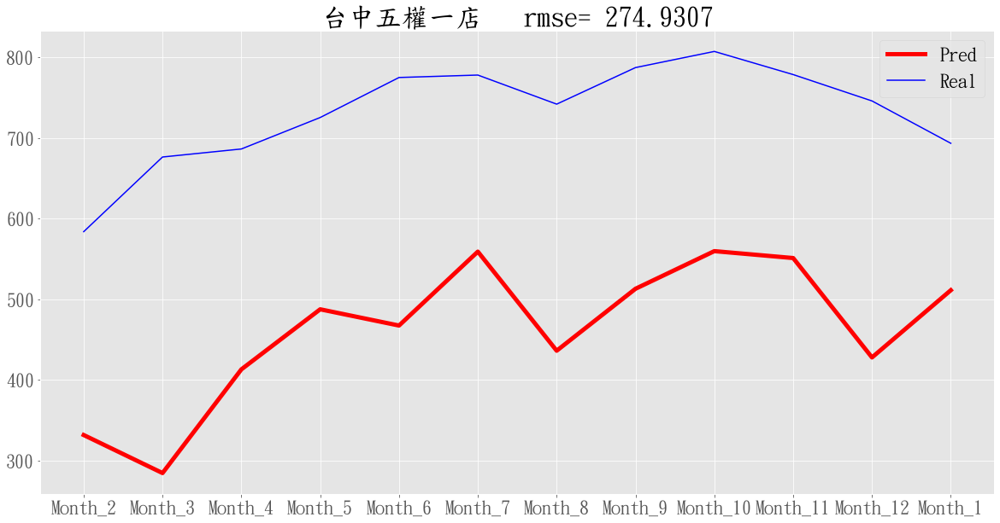

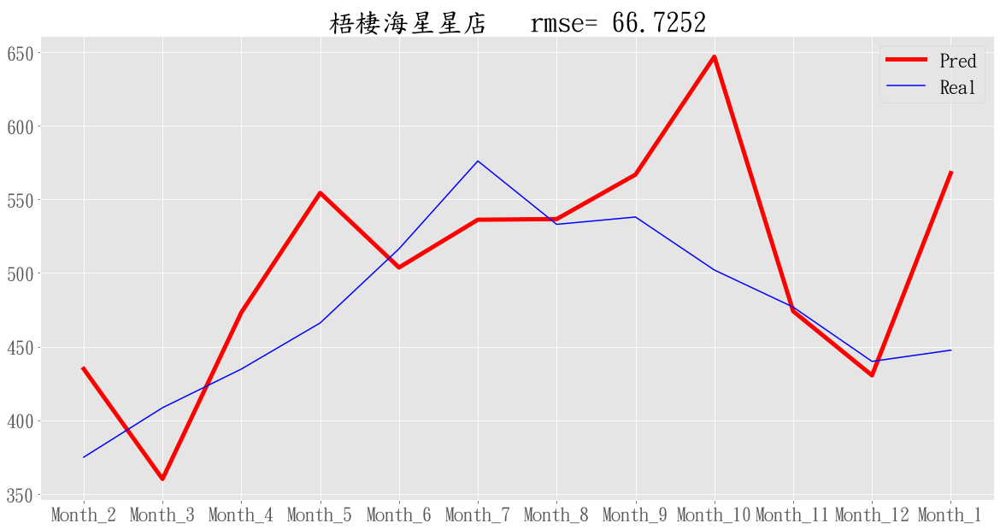

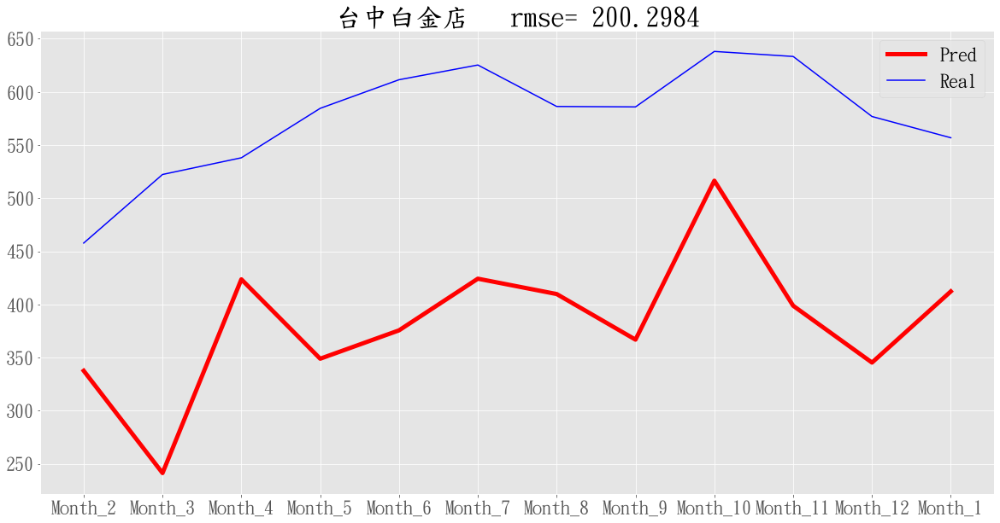

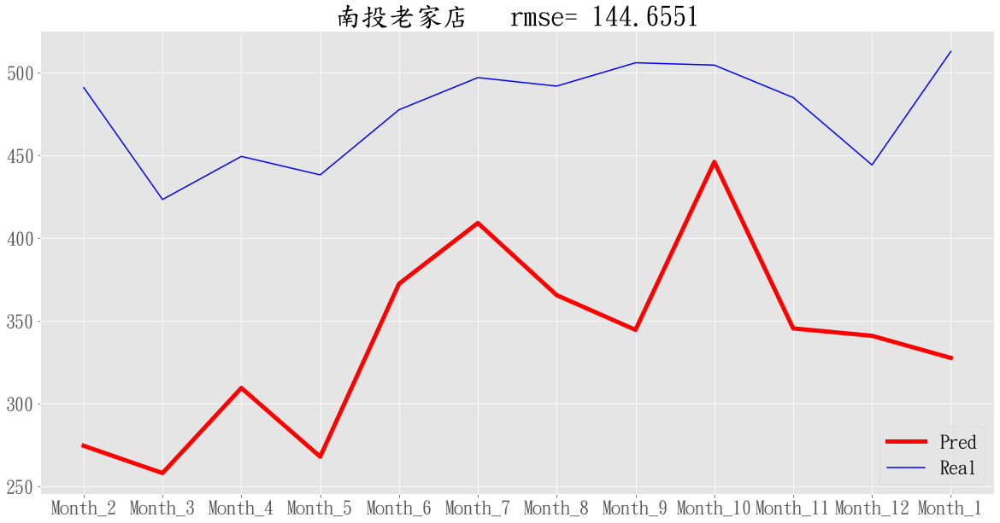

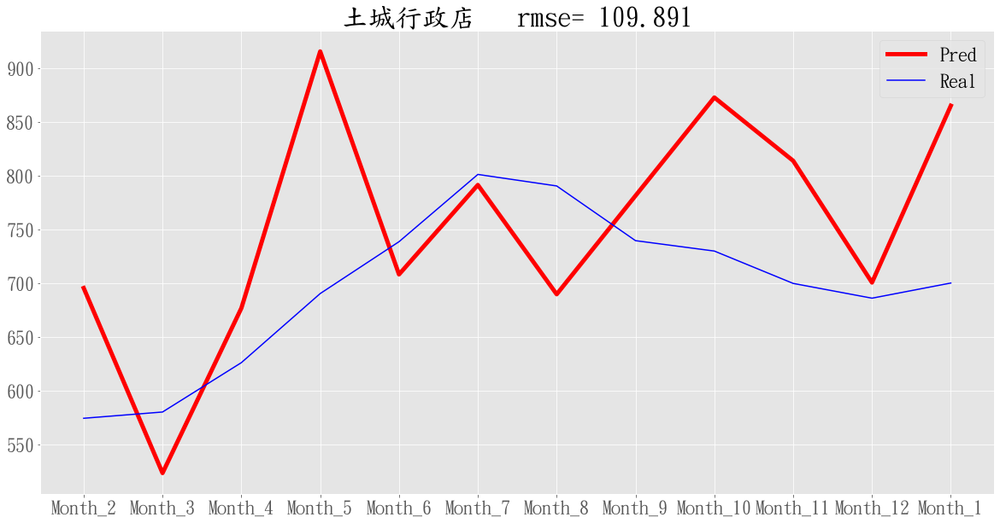

...

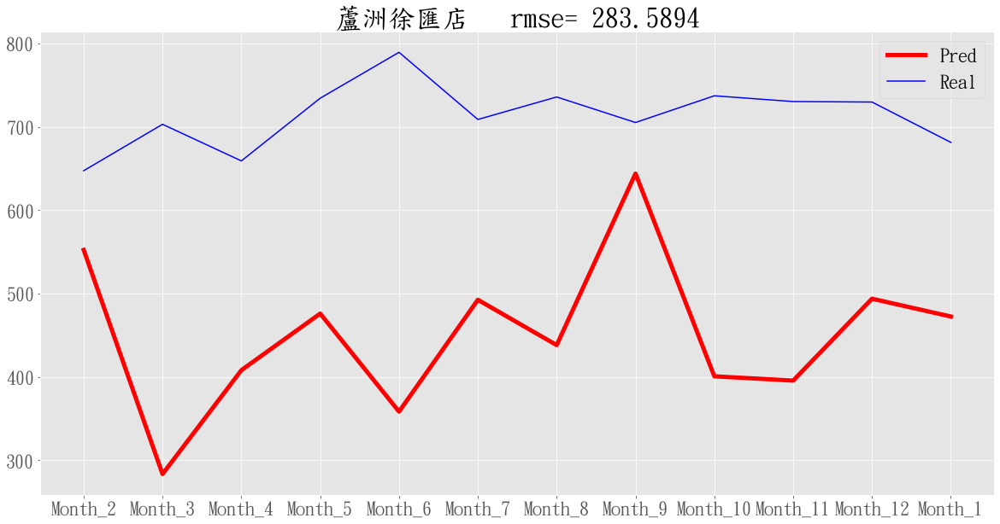

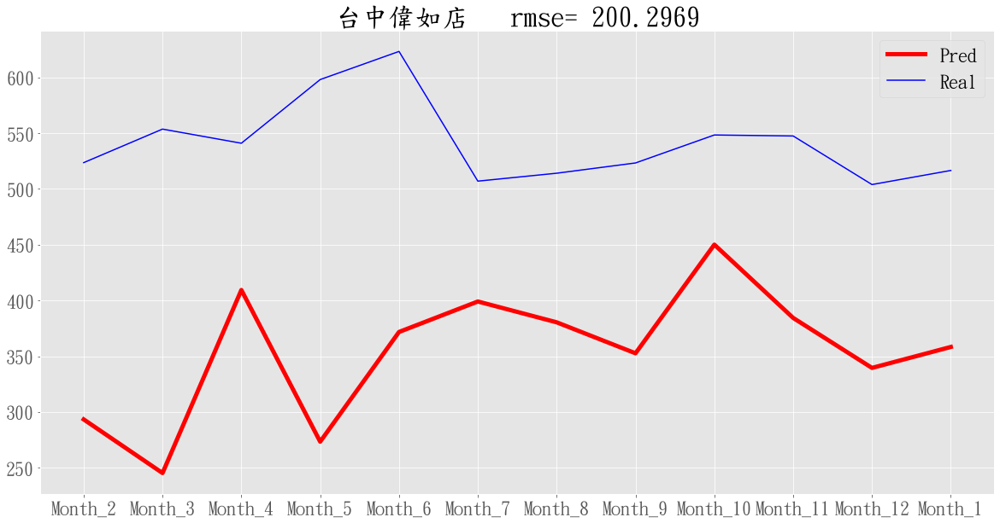

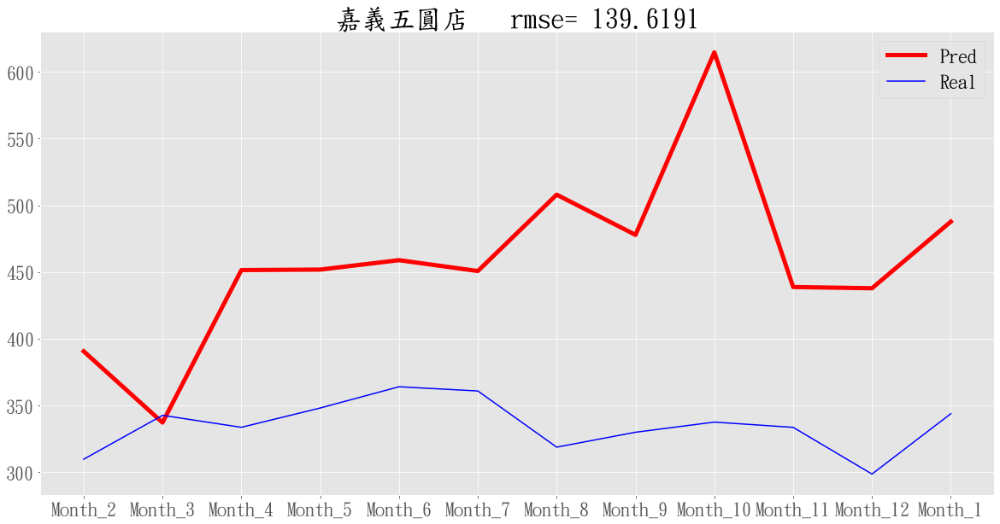

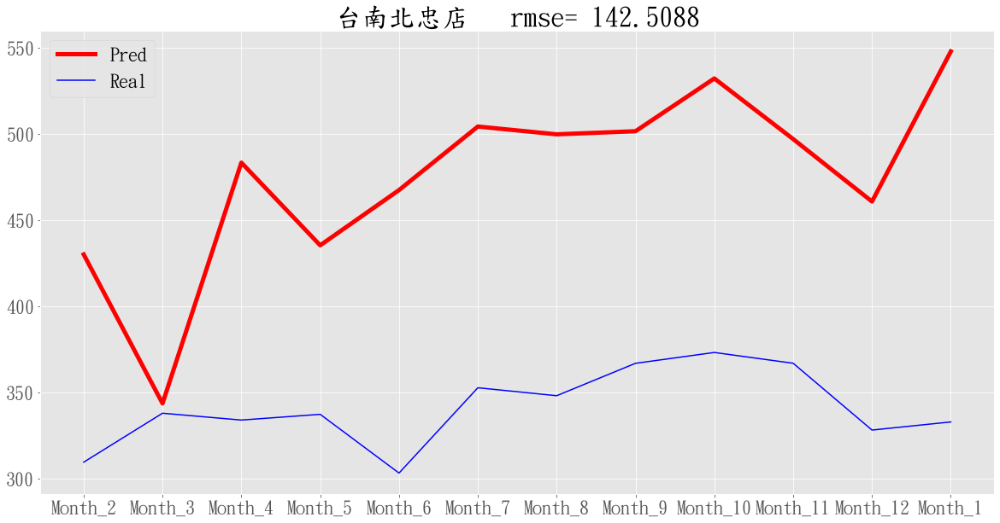

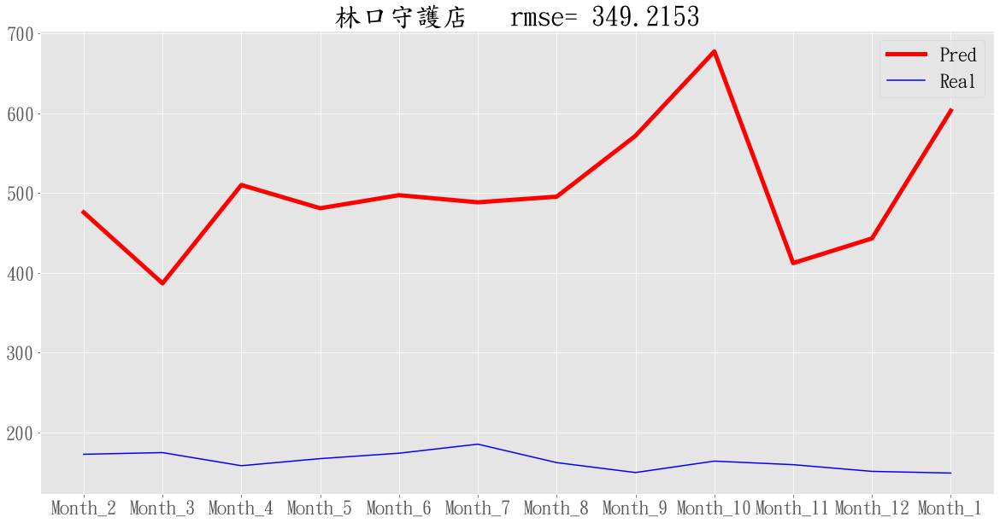

In [240]:
# save_path = './Result/Pic_RBF_FS_NN_NormalizeNew'
# os.mkdir(save_path)

font = {'family' : 'DFKai-SB',
'weight' : 'bold',
'size'  : '22'}
plt.rc('font', **font)

for i in range(len(predict)):
    rmse = np.sqrt(metrics.mean_squared_error(target_108_real_df.iloc[i, 1:-1], predict.iloc[i, 1:-1]))
    plt.figure(figsize=(20,10))
    plt.plot(predict.iloc[i, 1:-1], "red", label = "Pred", linewidth=5)
    plt.plot(target_108_real_df.iloc[i, 1:-1].astype('float32'), "blue", label = "Real")
    plt.title(target_108_real_df['name'].tolist()[i] + '   rmse= ' + str(round(rmse, 4)))
    plt.legend()
    plt.savefig('./Result/Round_1/Each_store_NN_Predict_' + target_108_real_df['name'].tolist()[i] + '.png')
    plt.show()
    plt.close()

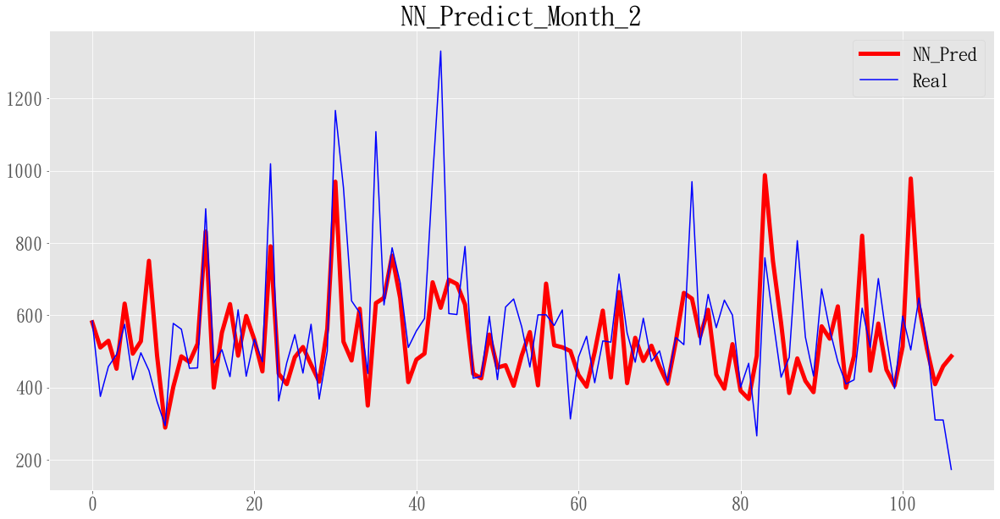

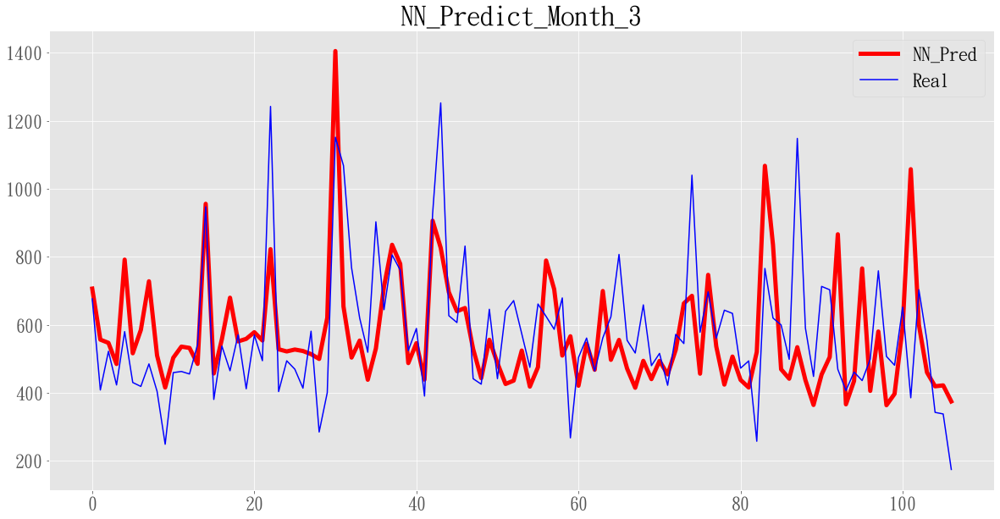

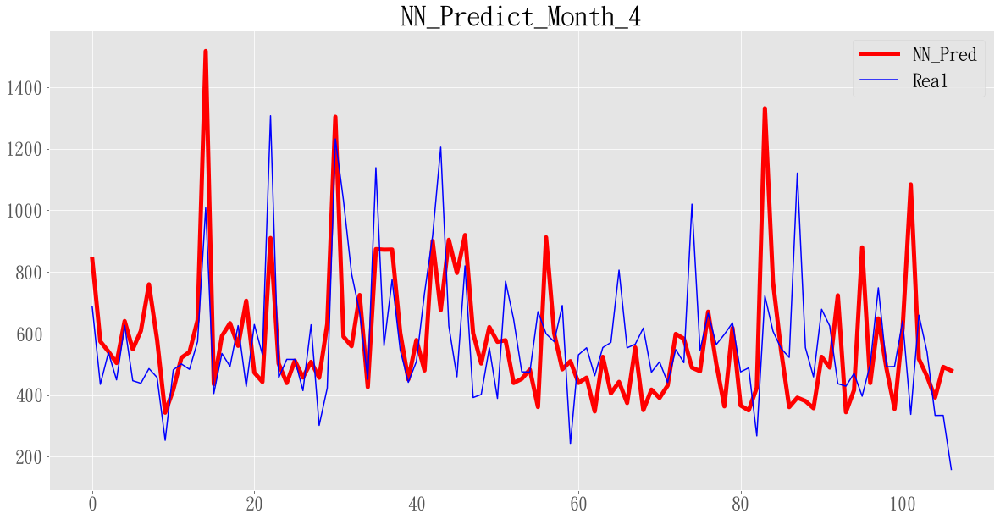

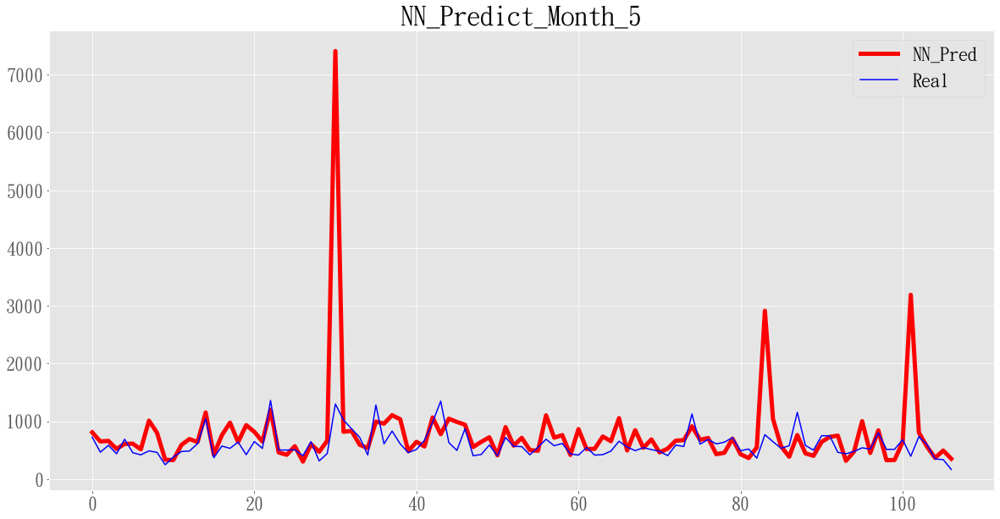

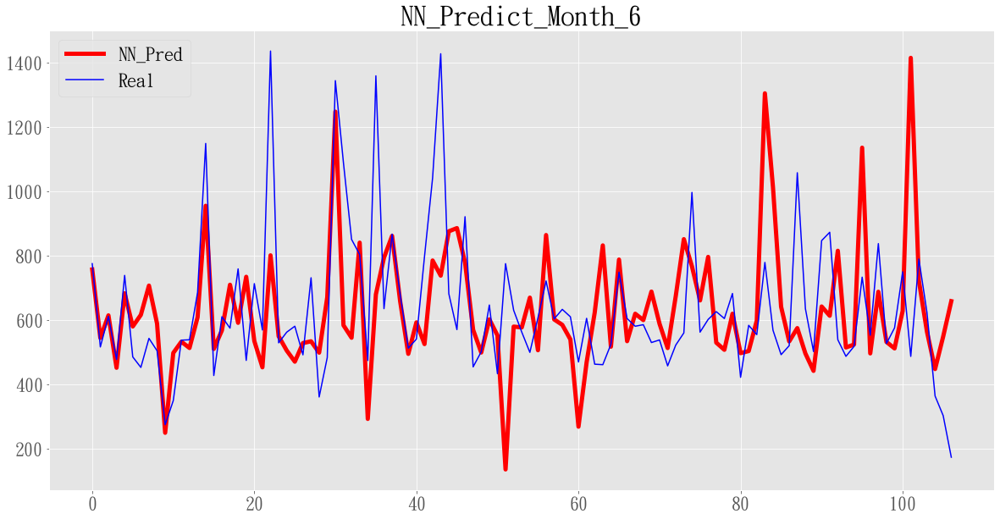

...

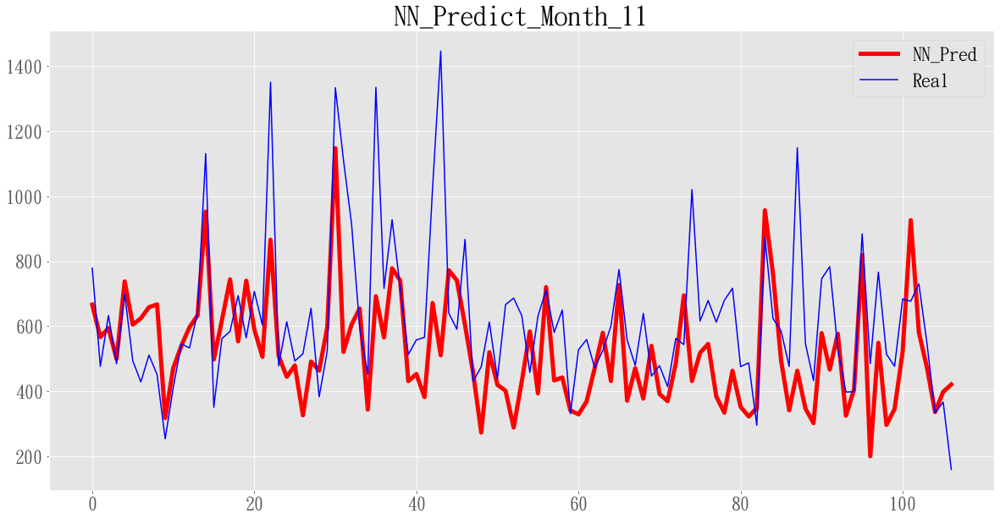

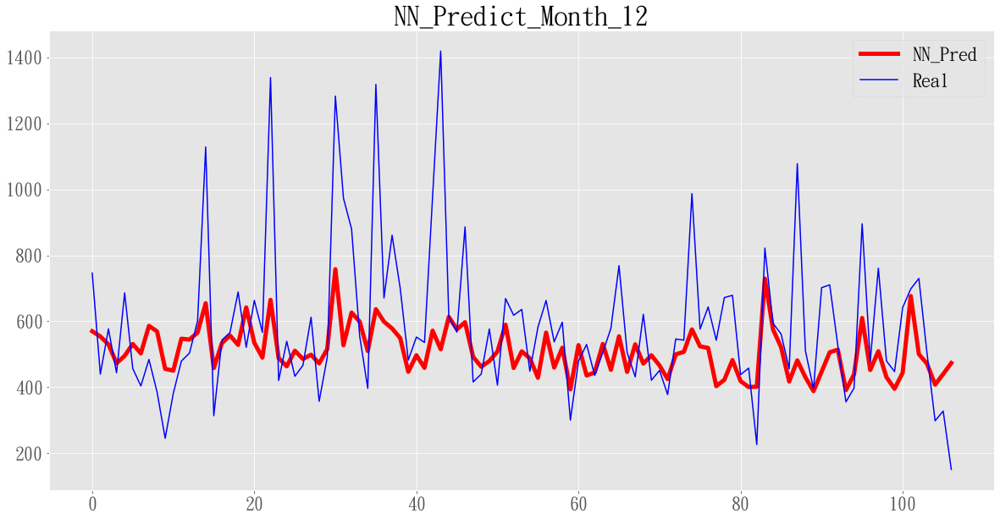

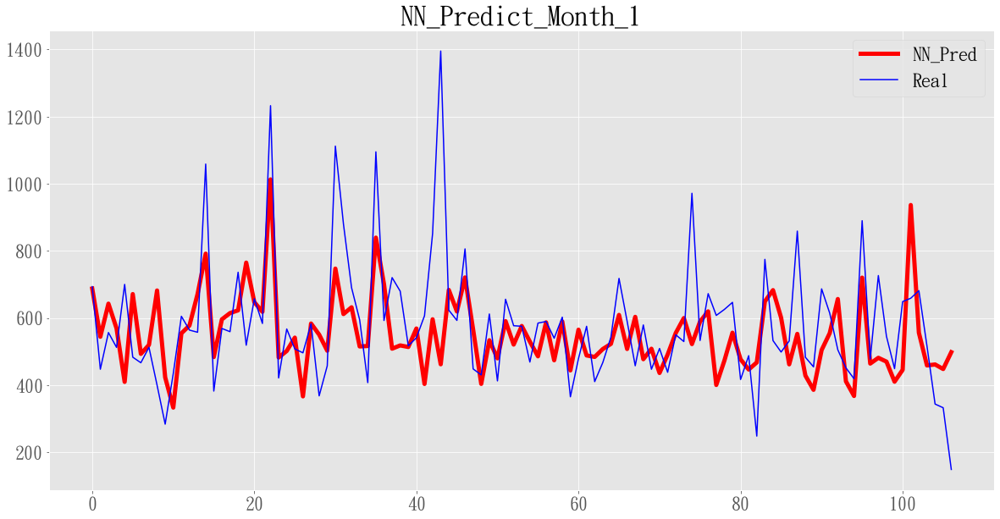

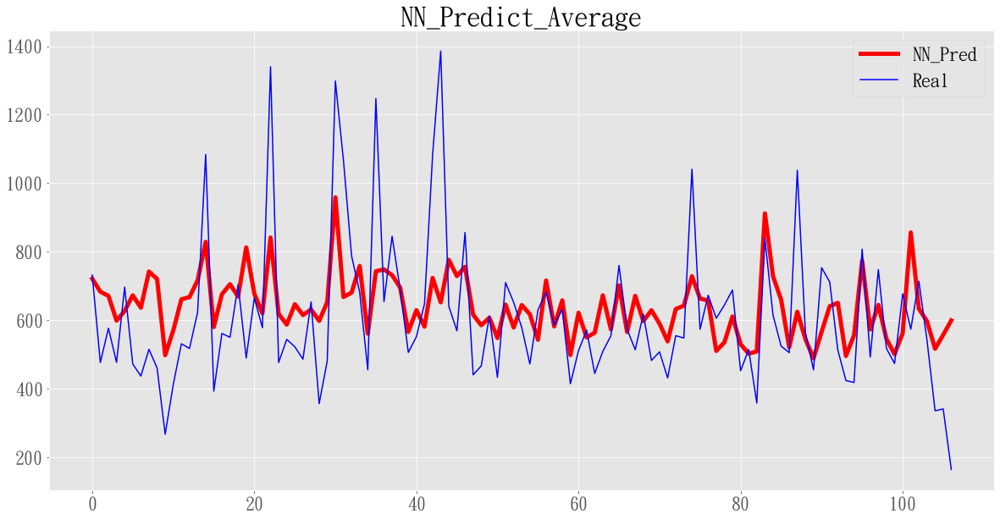

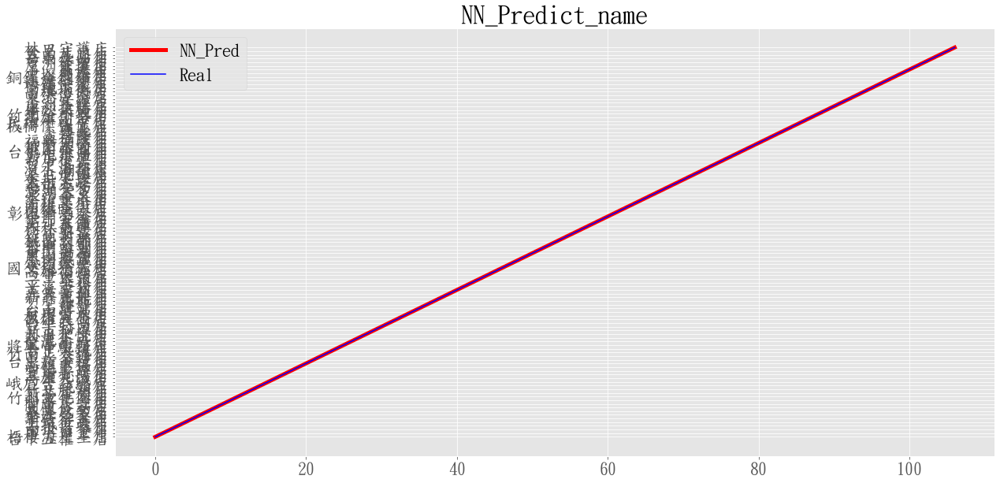

In [350]:
for name in predict.columns.tolist():
    plt.figure(figsize=(20,10))
    plt.rcParams.update({'font.size': 22})
    plt.plot(predict[name], "red", label = "NN_Pred", linewidth=5)
    plt.plot(target_108_real_df[name], "blue", label = "Real")
    plt.title("NN_Predict_" + name)
    plt.legend()
#     plt.savefig('./Result/Pic_FS_RBF/NN_Predict_Each_Month_' + name + '.jpg')
    plt.show()
    plt.close()

In [251]:
month_pred = []

for i in range(12):
    train = train_df_scale[important_feature[i]]
    test = test_df_scale[important_feature[i]]
    model = create_rbf_model(train)
    history = model.fit(train, train_target.iloc[:, i], epochs=200, validation_split=0.1, callbacks=callbacks)
    month_pred.append(model.predict(test))
#     model.save('NN_Month_' + str(i) + '.h5')
    
    tf.keras.backend.clear_session()

Epoch 1/200
6/6 [==============================] - 0s 16ms/step - loss: 0.1107 - val_loss: 0.0752
Epoch 2/200
6/6 [==============================] - 0s 2ms/step - loss: 0.0406 - val_loss: 0.0173
Epoch 3/200
6/6 [==============================] - 0s 2ms/step - loss: 0.0229 - val_loss: 0.0117
Epoch 4/200
6/6 [==============================] - 0s 3ms/step - loss: 0.0191 - val_loss: 0.0282
Epoch 5/200
6/6 [==============================] - 0s 2ms/step - loss: 0.0168 - val_loss: 0.0254
Epoch 6/200
6/6 [==============================] - 0s 3ms/step - loss: 0.0147 - val_loss: 0.0190
Epoch 7/200
6/6 [==============================] - 0s 3ms/step - loss: 0.0144 - val_loss: 0.0265
Epoch 8/200
6/6 [==============================] - 0s 2ms/step - loss: 0.0137 - val_loss: 0.0293
Epoch 9/200
6/6 [==============================] - 0s 3ms/step - loss: 0.0133 - val_loss: 0.0291
Epoch 10/200
6/6 [==============================] - 0s 2ms/step - loss: 0.0139 - val_loss: 0.0355
Epoch 11/200
6/6 [==========

Epoch 165/200
6/6 [==============================] - 0s 3ms/step - loss: 0.0102 - val_loss: 0.0517
Epoch 166/200
6/6 [==============================] - 0s 3ms/step - loss: 0.0102 - val_loss: 0.0517
Epoch 167/200
6/6 [==============================] - 0s 3ms/step - loss: 0.0102 - val_loss: 0.0518
Epoch 168/200
6/6 [==============================] - 0s 3ms/step - loss: 0.0102 - val_loss: 0.0523
Epoch 169/200
6/6 [==============================] - 0s 3ms/step - loss: 0.0102 - val_loss: 0.0524
Epoch 170/200
6/6 [==============================] - 0s 3ms/step - loss: 0.0102 - val_loss: 0.0526
Epoch 171/200
6/6 [==============================] - ETA: 0s - loss: 0.014 - 0s 2ms/step - loss: 0.0102 - val_loss: 0.0529
Epoch 172/200
6/6 [==============================] - 0s 2ms/step - loss: 0.0102 - val_loss: 0.0530
Epoch 173/200
6/6 [==============================] - 0s 2ms/step - loss: 0.0102 - val_loss: 0.0536
Epoch 174/200
6/6 [==============================] - 0s 2ms/step - loss: 0.0102 - val

6/6 [==============================] - 0s 2ms/step - loss: 0.0117 - val_loss: 0.0389
Epoch 127/200
6/6 [==============================] - 0s 2ms/step - loss: 0.0117 - val_loss: 0.0389
Epoch 128/200
6/6 [==============================] - 0s 2ms/step - loss: 0.0117 - val_loss: 0.0389
Epoch 129/200
6/6 [==============================] - 0s 2ms/step - loss: 0.0117 - val_loss: 0.0389
Epoch 130/200
6/6 [==============================] - 0s 2ms/step - loss: 0.0117 - val_loss: 0.0389
Epoch 131/200
6/6 [==============================] - 0s 2ms/step - loss: 0.0117 - val_loss: 0.0389
Epoch 132/200
6/6 [==============================] - 0s 2ms/step - loss: 0.0117 - val_loss: 0.0389
Epoch 133/200
6/6 [==============================] - 0s 3ms/step - loss: 0.0117 - val_loss: 0.0388
Epoch 134/200
6/6 [==============================] - 0s 3ms/step - loss: 0.0117 - val_loss: 0.0388
Epoch 135/200
6/6 [==============================] - 0s 2ms/step - loss: 0.0117 - val_loss: 0.0388
Epoch 136/200
6/6 [=====

Epoch 6/200
6/6 [==============================] - 0s 3ms/step - loss: 0.0114 - val_loss: 0.0223
Epoch 7/200
6/6 [==============================] - ETA: 0s - loss: 0.013 - 0s 2ms/step - loss: 0.0131 - val_loss: 0.0145
Epoch 8/200
6/6 [==============================] - 0s 2ms/step - loss: 0.0128 - val_loss: 0.0427
Epoch 9/200
6/6 [==============================] - 0s 2ms/step - loss: 0.0166 - val_loss: 0.0186
Epoch 10/200
6/6 [==============================] - 0s 2ms/step - loss: 0.0117 - val_loss: 0.0260
Epoch 11/200
6/6 [==============================] - 0s 2ms/step - loss: 0.0116 - val_loss: 0.0176
Epoch 12/200
6/6 [==============================] - 0s 2ms/step - loss: 0.0116 - val_loss: 0.0236
Epoch 13/200
6/6 [==============================] - 0s 2ms/step - loss: 0.0101 - val_loss: 0.0206
Epoch 14/200
6/6 [==============================] - 0s 2ms/step - loss: 0.0094 - val_loss: 0.0207
Epoch 15/200
6/6 [==============================] - 0s 2ms/step - loss: 0.0088 - val_loss: 0.0225


Epoch 89/200
6/6 [==============================] - ETA: 0s - loss: 0.006 - 0s 2ms/step - loss: 0.0068 - val_loss: 0.0221
Epoch 90/200
6/6 [==============================] - ETA: 0s - loss: 0.002 - 0s 3ms/step - loss: 0.0068 - val_loss: 0.0220
Epoch 91/200
6/6 [==============================] - 0s 3ms/step - loss: 0.0068 - val_loss: 0.0218
Epoch 92/200
6/6 [==============================] - 0s 2ms/step - loss: 0.0068 - val_loss: 0.0220
Epoch 93/200
6/6 [==============================] - 0s 2ms/step - loss: 0.0068 - val_loss: 0.0222
Epoch 94/200
6/6 [==============================] - 0s 2ms/step - loss: 0.0068 - val_loss: 0.0222
Epoch 95/200
6/6 [==============================] - 0s 2ms/step - loss: 0.0068 - val_loss: 0.0222
Epoch 96/200
6/6 [==============================] - 0s 2ms/step - loss: 0.0068 - val_loss: 0.0224
Epoch 97/200
6/6 [==============================] - 0s 2ms/step - loss: 0.0068 - val_loss: 0.0225
Epoch 98/200
6/6 [==============================] - 0s 2ms/step - loss

6/6 [==============================] - 0s 2ms/step - loss: 0.0066 - val_loss: 0.0233
Epoch 172/200
6/6 [==============================] - 0s 3ms/step - loss: 0.0066 - val_loss: 0.0232
Epoch 173/200
6/6 [==============================] - 0s 2ms/step - loss: 0.0066 - val_loss: 0.0230
Epoch 174/200
6/6 [==============================] - 0s 2ms/step - loss: 0.0066 - val_loss: 0.0229
Epoch 175/200
6/6 [==============================] - 0s 3ms/step - loss: 0.0066 - val_loss: 0.0228
Epoch 176/200
6/6 [==============================] - 0s 3ms/step - loss: 0.0066 - val_loss: 0.0227
Epoch 177/200
6/6 [==============================] - 0s 3ms/step - loss: 0.0066 - val_loss: 0.0227
Epoch 178/200
6/6 [==============================] - 0s 2ms/step - loss: 0.0066 - val_loss: 0.0229
Epoch 179/200
6/6 [==============================] - 0s 3ms/step - loss: 0.0066 - val_loss: 0.0228
Epoch 180/200
6/6 [==============================] - 0s 3ms/step - loss: 0.0066 - val_loss: 0.0227
Epoch 181/200
6/6 [=====

Epoch 54/200
6/6 [==============================] - 0s 2ms/step - loss: 0.0178 - val_loss: 0.0219
Epoch 55/200
6/6 [==============================] - 0s 2ms/step - loss: 0.0178 - val_loss: 0.0224
Epoch 56/200
6/6 [==============================] - 0s 2ms/step - loss: 0.0178 - val_loss: 0.0222
Epoch 57/200
6/6 [==============================] - 0s 2ms/step - loss: 0.0178 - val_loss: 0.0217
Epoch 58/200
6/6 [==============================] - 0s 3ms/step - loss: 0.0178 - val_loss: 0.0218
Epoch 59/200
6/6 [==============================] - 0s 3ms/step - loss: 0.0177 - val_loss: 0.0224
Epoch 60/200
6/6 [==============================] - 0s 2ms/step - loss: 0.0177 - val_loss: 0.0227
Epoch 61/200
6/6 [==============================] - 0s 3ms/step - loss: 0.0177 - val_loss: 0.0228
Epoch 62/200
6/6 [==============================] - 0s 2ms/step - loss: 0.0177 - val_loss: 0.0232
Epoch 63/200
6/6 [==============================] - 0s 3ms/step - loss: 0.0177 - val_loss: 0.0231
Epoch 64/200
6/6 [==

Epoch 136/200
6/6 [==============================] - 0s 2ms/step - loss: 0.0173 - val_loss: 0.0236
Epoch 137/200
6/6 [==============================] - 0s 2ms/step - loss: 0.0173 - val_loss: 0.0233
Epoch 138/200
6/6 [==============================] - 0s 2ms/step - loss: 0.0173 - val_loss: 0.0232
Epoch 139/200
6/6 [==============================] - 0s 2ms/step - loss: 0.0173 - val_loss: 0.0231
Epoch 140/200
6/6 [==============================] - 0s 2ms/step - loss: 0.0173 - val_loss: 0.0231
Epoch 141/200
6/6 [==============================] - 0s 2ms/step - loss: 0.0173 - val_loss: 0.0234
Epoch 142/200
6/6 [==============================] - 0s 2ms/step - loss: 0.0173 - val_loss: 0.0238
Epoch 143/200
6/6 [==============================] - 0s 3ms/step - loss: 0.0173 - val_loss: 0.0243
Epoch 144/200
6/6 [==============================] - 0s 3ms/step - loss: 0.0173 - val_loss: 0.0246
Epoch 145/200
6/6 [==============================] - 0s 2ms/step - loss: 0.0173 - val_loss: 0.0248
Epoch 146/

Epoch 99/200
6/6 [==============================] - 0s 2ms/step - loss: 0.0177 - val_loss: 0.0426
Epoch 100/200
6/6 [==============================] - ETA: 0s - loss: 0.024 - 0s 3ms/step - loss: 0.0177 - val_loss: 0.0431
Epoch 101/200
6/6 [==============================] - 0s 2ms/step - loss: 0.0177 - val_loss: 0.0431
Epoch 102/200
6/6 [==============================] - 0s 2ms/step - loss: 0.0177 - val_loss: 0.0426
Epoch 103/200
6/6 [==============================] - 0s 2ms/step - loss: 0.0177 - val_loss: 0.0427
Epoch 104/200
6/6 [==============================] - 0s 2ms/step - loss: 0.0177 - val_loss: 0.0424
Epoch 105/200
6/6 [==============================] - 0s 2ms/step - loss: 0.0177 - val_loss: 0.0423
Epoch 106/200
6/6 [==============================] - 0s 2ms/step - loss: 0.0177 - val_loss: 0.0426
Epoch 107/200
6/6 [==============================] - ETA: 0s - loss: 0.021 - 0s 2ms/step - loss: 0.0177 - val_loss: 0.0430
Epoch 108/200
6/6 [==============================] - 0s 3ms/st

Epoch 180/200
6/6 [==============================] - 0s 2ms/step - loss: 0.0175 - val_loss: 0.0421
Epoch 181/200
6/6 [==============================] - 0s 3ms/step - loss: 0.0175 - val_loss: 0.0421
Epoch 182/200
6/6 [==============================] - ETA: 0s - loss: 0.013 - 0s 2ms/step - loss: 0.0175 - val_loss: 0.0417
Epoch 183/200
6/6 [==============================] - 0s 2ms/step - loss: 0.0174 - val_loss: 0.0420
Epoch 184/200
6/6 [==============================] - 0s 3ms/step - loss: 0.0175 - val_loss: 0.0422
Epoch 185/200
6/6 [==============================] - 0s 3ms/step - loss: 0.0175 - val_loss: 0.0422
Epoch 186/200
6/6 [==============================] - 0s 2ms/step - loss: 0.0174 - val_loss: 0.0415
Epoch 187/200
6/6 [==============================] - 0s 2ms/step - loss: 0.0175 - val_loss: 0.0403
Epoch 188/200
6/6 [==============================] - 0s 3ms/step - loss: 0.0175 - val_loss: 0.0401
Epoch 189/200
6/6 [==============================] - 0s 3ms/step - loss: 0.0175 - val

Epoch 62/200
6/6 [==============================] - 0s 3ms/step - loss: 0.0111 - val_loss: 0.0351
Epoch 63/200
6/6 [==============================] - 0s 3ms/step - loss: 0.0111 - val_loss: 0.0353
Epoch 64/200
6/6 [==============================] - 0s 2ms/step - loss: 0.0111 - val_loss: 0.0357
Epoch 65/200
6/6 [==============================] - ETA: 0s - loss: 0.008 - 0s 3ms/step - loss: 0.0111 - val_loss: 0.0360
Epoch 66/200
6/6 [==============================] - 0s 3ms/step - loss: 0.0111 - val_loss: 0.0364
Epoch 67/200
6/6 [==============================] - 0s 3ms/step - loss: 0.0111 - val_loss: 0.0365
Epoch 68/200
6/6 [==============================] - 0s 3ms/step - loss: 0.0111 - val_loss: 0.0366
Epoch 69/200
6/6 [==============================] - 0s 3ms/step - loss: 0.0111 - val_loss: 0.0364
Epoch 70/200
6/6 [==============================] - 0s 3ms/step - loss: 0.0111 - val_loss: 0.0360
Epoch 71/200
6/6 [==============================] - 0s 2ms/step - loss: 0.0111 - val_loss: 0.0

Epoch 144/200
6/6 [==============================] - 0s 2ms/step - loss: 0.0109 - val_loss: 0.0365
Epoch 145/200
6/6 [==============================] - 0s 2ms/step - loss: 0.0109 - val_loss: 0.0365
Epoch 146/200
6/6 [==============================] - 0s 2ms/step - loss: 0.0109 - val_loss: 0.0359
Epoch 147/200
6/6 [==============================] - 0s 2ms/step - loss: 0.0109 - val_loss: 0.0352
Epoch 148/200
6/6 [==============================] - 0s 2ms/step - loss: 0.0109 - val_loss: 0.0350
Epoch 149/200
6/6 [==============================] - 0s 2ms/step - loss: 0.0109 - val_loss: 0.0347
Epoch 150/200
6/6 [==============================] - 0s 2ms/step - loss: 0.0109 - val_loss: 0.0341
Epoch 151/200
6/6 [==============================] - 0s 2ms/step - loss: 0.0109 - val_loss: 0.0340
Epoch 152/200
6/6 [==============================] - 0s 3ms/step - loss: 0.0109 - val_loss: 0.0344
Epoch 153/200
6/6 [==============================] - 0s 2ms/step - loss: 0.0108 - val_loss: 0.0349
Epoch 154/

6/6 [==============================] - 0s 2ms/step - loss: 0.0121 - val_loss: 0.0520
Epoch 109/200
6/6 [==============================] - 0s 2ms/step - loss: 0.0121 - val_loss: 0.0518
Epoch 110/200
6/6 [==============================] - 0s 2ms/step - loss: 0.0121 - val_loss: 0.0516
Epoch 111/200
6/6 [==============================] - 0s 2ms/step - loss: 0.0121 - val_loss: 0.0517
Epoch 112/200
6/6 [==============================] - 0s 2ms/step - loss: 0.0121 - val_loss: 0.0517
Epoch 113/200
6/6 [==============================] - 0s 2ms/step - loss: 0.0121 - val_loss: 0.0517
Epoch 114/200
6/6 [==============================] - 0s 2ms/step - loss: 0.0121 - val_loss: 0.0520
Epoch 115/200
6/6 [==============================] - 0s 3ms/step - loss: 0.0121 - val_loss: 0.0519
Epoch 116/200
6/6 [==============================] - 0s 2ms/step - loss: 0.0121 - val_loss: 0.0515
Epoch 117/200
6/6 [==============================] - 0s 3ms/step - loss: 0.0121 - val_loss: 0.0513
Epoch 118/200
6/6 [=====

Epoch 190/200
6/6 [==============================] - 0s 2ms/step - loss: 0.0117 - val_loss: 0.0521
Epoch 191/200
6/6 [==============================] - 0s 2ms/step - loss: 0.0118 - val_loss: 0.0516
Epoch 192/200
6/6 [==============================] - 0s 2ms/step - loss: 0.0118 - val_loss: 0.0512
Epoch 193/200
6/6 [==============================] - 0s 2ms/step - loss: 0.0118 - val_loss: 0.0513
Epoch 194/200
6/6 [==============================] - 0s 3ms/step - loss: 0.0118 - val_loss: 0.0512
Epoch 195/200
6/6 [==============================] - 0s 2ms/step - loss: 0.0118 - val_loss: 0.0515
Epoch 196/200
6/6 [==============================] - 0s 2ms/step - loss: 0.0117 - val_loss: 0.0516
Epoch 197/200
6/6 [==============================] - 0s 2ms/step - loss: 0.0117 - val_loss: 0.0516
Epoch 198/200
6/6 [==============================] - 0s 2ms/step - loss: 0.0117 - val_loss: 0.0519
Epoch 199/200
6/6 [==============================] - 0s 2ms/step - loss: 0.0117 - val_loss: 0.0518
Epoch 200/

6/6 [==============================] - 0s 2ms/step - loss: 0.0160 - val_loss: 0.0454
Epoch 153/200
6/6 [==============================] - 0s 2ms/step - loss: 0.0160 - val_loss: 0.0455
Epoch 154/200
6/6 [==============================] - 0s 2ms/step - loss: 0.0160 - val_loss: 0.0454
Epoch 155/200
6/6 [==============================] - 0s 3ms/step - loss: 0.0160 - val_loss: 0.0455
Epoch 156/200
6/6 [==============================] - 0s 2ms/step - loss: 0.0160 - val_loss: 0.0455
Epoch 157/200
6/6 [==============================] - 0s 2ms/step - loss: 0.0160 - val_loss: 0.0455
Epoch 158/200
6/6 [==============================] - 0s 2ms/step - loss: 0.0160 - val_loss: 0.0454
Epoch 159/200
6/6 [==============================] - 0s 2ms/step - loss: 0.0160 - val_loss: 0.0452
Epoch 160/200
6/6 [==============================] - ETA: 0s - loss: 0.011 - 0s 2ms/step - loss: 0.0159 - val_loss: 0.0448
Epoch 161/200
6/6 [==============================] - 0s 3ms/step - loss: 0.0160 - val_loss: 0.0446


6/6 [==============================] - 0s 2ms/step - loss: 0.0066 - val_loss: 0.0217
Epoch 35/200
6/6 [==============================] - 0s 2ms/step - loss: 0.0066 - val_loss: 0.0228
Epoch 36/200
6/6 [==============================] - 0s 2ms/step - loss: 0.0066 - val_loss: 0.0224
Epoch 37/200
6/6 [==============================] - 0s 2ms/step - loss: 0.0065 - val_loss: 0.0226
Epoch 38/200
6/6 [==============================] - 0s 2ms/step - loss: 0.0065 - val_loss: 0.0205
Epoch 39/200
6/6 [==============================] - 0s 2ms/step - loss: 0.0065 - val_loss: 0.0204
Epoch 40/200
6/6 [==============================] - 0s 3ms/step - loss: 0.0065 - val_loss: 0.0187
Epoch 41/200
6/6 [==============================] - 0s 3ms/step - loss: 0.0065 - val_loss: 0.0202
Epoch 42/200
6/6 [==============================] - 0s 3ms/step - loss: 0.0064 - val_loss: 0.0220
Epoch 43/200
6/6 [==============================] - 0s 2ms/step - loss: 0.0064 - val_loss: 0.0219
Epoch 44/200
6/6 [===============

6/6 [==============================] - 0s 2ms/step - loss: 0.0061 - val_loss: 0.0217
Epoch 117/200
6/6 [==============================] - ETA: 0s - loss: 0.002 - 0s 2ms/step - loss: 0.0061 - val_loss: 0.0213
Epoch 118/200
6/6 [==============================] - 0s 2ms/step - loss: 0.0061 - val_loss: 0.0208
Epoch 119/200
6/6 [==============================] - 0s 2ms/step - loss: 0.0061 - val_loss: 0.0208
Epoch 120/200
6/6 [==============================] - 0s 2ms/step - loss: 0.0061 - val_loss: 0.0210
Epoch 121/200
6/6 [==============================] - 0s 2ms/step - loss: 0.0061 - val_loss: 0.0209
Epoch 122/200
6/6 [==============================] - 0s 2ms/step - loss: 0.0061 - val_loss: 0.0207
Epoch 123/200
6/6 [==============================] - 0s 2ms/step - loss: 0.0061 - val_loss: 0.0211
Epoch 124/200
6/6 [==============================] - 0s 2ms/step - loss: 0.0061 - val_loss: 0.0219
Epoch 125/200
6/6 [==============================] - ETA: 0s - loss: 0.003 - 0s 2ms/step - loss: 0.

6/6 [==============================] - 0s 3ms/step - loss: 0.0125 - val_loss: 0.0197
Epoch 80/200
6/6 [==============================] - 0s 3ms/step - loss: 0.0125 - val_loss: 0.0195
Epoch 81/200
6/6 [==============================] - 0s 3ms/step - loss: 0.0125 - val_loss: 0.0190
Epoch 82/200
6/6 [==============================] - 0s 2ms/step - loss: 0.0125 - val_loss: 0.0188
Epoch 83/200
6/6 [==============================] - 0s 3ms/step - loss: 0.0125 - val_loss: 0.0191
Epoch 84/200
6/6 [==============================] - 0s 3ms/step - loss: 0.0125 - val_loss: 0.0192
Epoch 85/200
6/6 [==============================] - 0s 3ms/step - loss: 0.0125 - val_loss: 0.0193
Epoch 86/200
6/6 [==============================] - 0s 2ms/step - loss: 0.0125 - val_loss: 0.0196
Epoch 87/200
6/6 [==============================] - 0s 2ms/step - loss: 0.0125 - val_loss: 0.0196
Epoch 88/200
6/6 [==============================] - 0s 3ms/step - loss: 0.0125 - val_loss: 0.0195
Epoch 89/200
6/6 [===============

Epoch 42/200
6/6 [==============================] - 0s 2ms/step - loss: 0.0131 - val_loss: 0.0104
Epoch 43/200
6/6 [==============================] - 0s 2ms/step - loss: 0.0144 - val_loss: 0.0105
Epoch 44/200
6/6 [==============================] - 0s 2ms/step - loss: 0.0134 - val_loss: 0.0111
Epoch 45/200
6/6 [==============================] - ETA: 0s - loss: 0.016 - 0s 2ms/step - loss: 0.0132 - val_loss: 0.0123
Epoch 46/200
6/6 [==============================] - 0s 2ms/step - loss: 0.0135 - val_loss: 0.0120
Epoch 47/200
6/6 [==============================] - 0s 2ms/step - loss: 0.0131 - val_loss: 0.0108
Epoch 48/200
6/6 [==============================] - 0s 2ms/step - loss: 0.0128 - val_loss: 0.0105
Epoch 49/200
6/6 [==============================] - 0s 2ms/step - loss: 0.0131 - val_loss: 0.0106
Epoch 50/200
6/6 [==============================] - 0s 2ms/step - loss: 0.0127 - val_loss: 0.0109
Epoch 51/200
6/6 [==============================] - ETA: 0s - loss: 0.011 - 0s 2ms/step - loss

Epoch 2/200
6/6 [==============================] - 0s 2ms/step - loss: 0.0268 - val_loss: 0.0370
Epoch 3/200
6/6 [==============================] - 0s 2ms/step - loss: 0.0267 - val_loss: 0.0441
Epoch 4/200
6/6 [==============================] - 0s 2ms/step - loss: 0.0207 - val_loss: 0.0254
Epoch 5/200
6/6 [==============================] - 0s 2ms/step - loss: 0.0214 - val_loss: 0.0362
Epoch 6/200
6/6 [==============================] - 0s 3ms/step - loss: 0.0200 - val_loss: 0.0302
Epoch 7/200
6/6 [==============================] - 0s 2ms/step - loss: 0.0194 - val_loss: 0.0373
Epoch 8/200
6/6 [==============================] - 0s 3ms/step - loss: 0.0171 - val_loss: 0.0277
Epoch 9/200
6/6 [==============================] - 0s 2ms/step - loss: 0.0170 - val_loss: 0.0415
Epoch 10/200
6/6 [==============================] - 0s 3ms/step - loss: 0.0167 - val_loss: 0.0293
Epoch 11/200
6/6 [==============================] - 0s 2ms/step - loss: 0.0168 - val_loss: 0.0412
Epoch 12/200
6/6 [==========

6/6 [==============================] - 0s 3ms/step - loss: 0.0096 - val_loss: 0.0385
Epoch 166/200
6/6 [==============================] - 0s 3ms/step - loss: 0.0096 - val_loss: 0.0378
Epoch 167/200
6/6 [==============================] - 0s 3ms/step - loss: 0.0096 - val_loss: 0.0374
Epoch 168/200
6/6 [==============================] - 0s 2ms/step - loss: 0.0096 - val_loss: 0.0375
Epoch 169/200
6/6 [==============================] - 0s 2ms/step - loss: 0.0096 - val_loss: 0.0380
Epoch 170/200
6/6 [==============================] - 0s 3ms/step - loss: 0.0096 - val_loss: 0.0384
Epoch 171/200
6/6 [==============================] - 0s 3ms/step - loss: 0.0096 - val_loss: 0.0383
Epoch 172/200
6/6 [==============================] - 0s 2ms/step - loss: 0.0096 - val_loss: 0.0382
Epoch 173/200
6/6 [==============================] - 0s 2ms/step - loss: 0.0096 - val_loss: 0.0382
Epoch 174/200
6/6 [==============================] - 0s 2ms/step - loss: 0.0096 - val_loss: 0.0377
Epoch 175/200
6/6 [=====

In [252]:
df_predict = pd.DataFrame(np.array(month_pred)[0])

for i in range(1, len(month_pred)):
    df_predict[str(i)] = np.array(month_pred)[i]
    
df_predict = pd.DataFrame(target_scaler.inverse_transform(df_predict), columns=target_108_real_df.iloc[:, 1:].columns)

predict = df_predict * target_108_df.Average.values.reshape(-1, 1)


In [253]:
rmse_tot = np.sqrt(metrics.mean_squared_error(target_108_real_df.iloc[:, 1:], predict))
print(rmse_tot)

each_rmse = []
for i in range(len(predict)):
    rmse = np.sqrt(metrics.mean_squared_error(target_108_real_df.iloc[i, 1:], predict.iloc[i, :]))
    each_rmse.append(rmse)

df_each_rmse = pd.DataFrame(each_rmse, columns=['RMSE'], index=target_108_real_df['name'].tolist())
print(df_each_rmse.nsmallest(20, 'RMSE'))
print(df_each_rmse.nlargest(5, 'RMSE'))

73.83114279105689
             RMSE
林口守護店   11.598214
關廟八六店   19.678054
嘉義五圓店   24.204101
南投老家店   24.349383
草屯虎山店   24.456009
新竹得美店   26.088314
銅鑼金銅鑼店  26.601296
新營三族店   27.798529
高雄天誠店   27.806785
民雄十四甲店  28.145886
八德瑞豐店   30.070332
東港潭灣店   30.125303
水上中興店   30.581356
台南北忠店   31.349294
竹北金十興店  31.647151
埔心永坡店   32.060189
竹南大營店   32.189094
太平水悅店   32.357767
燕巢安招店   32.832732
台中偉如店   33.061554
             RMSE
台發店    240.787518
地下街店   240.532752
台南前站店  170.665795
墾丁大街店  139.199088
高雄大西店  138.762287


In [254]:
predict.to_csv('rbf_feature_select_RBF_predict.csv', index=0, encoding='utf-8-sig')

In [255]:
def result_plot():
    df_result = pd.read_csv('./Result/Result_NN_Predict_6.csv')
    data = df_result
    N = 50
    c = ['hsl(' + str(h) + ',50%' + ',50%)' for h in np.linspace(0, 360, N)]
    fig = go.Figure()
    for i in range(50):
        name = data.at[i, 'name']
        real = data.iloc[i, 1:13]
        pre = data.iloc[i, 13:]
        fig.add_trace(go.Box(y=real,
                             name=name,
                             marker_color=c[0]))
        fig.add_trace(go.Box(y=pre,
                             name=name,
                             marker_color=c[20]))
    fig.update_layout(
        # title='Origin_label_'+str(k)+'         '+'群內數量:'+str(len(data_k)),
        title='RBFNN_predict_result_108',
        xaxis=dict(showgrid=False, zeroline=False, showticklabels=True),
        yaxis=dict(zeroline=False, gridcolor='white'),
        paper_bgcolor='rgb(233,233,233)',
        plot_bgcolor='rgb(233,233,233)',
        showlegend=False,
    )
    fig.show()
    fig = go.Figure()
    for i in range(57):
        name = data.at[i+50, 'name']
        real = data.iloc[i+50, 1:13]
        pre = data.iloc[i+50, 13:]
        fig.add_trace(go.Box(y=real,
                             name=name ,
                             marker_color=c[0]))
        fig.add_trace(go.Box(y=pre,
                             name=name ,
                             marker_color=c[20]))
    fig.update_layout(
        # title='Origin_label_'+str(k)+'         '+'群內數量:'+str(len(data_k)),
        title='RBFNN_predict_result_108',
        xaxis=dict(showgrid=False, zeroline=False, showticklabels=True),
        yaxis=dict(zeroline=False, gridcolor='white'),
        paper_bgcolor='rgb(233,233,233)',
        plot_bgcolor='rgb(233,233,233)',
        showlegend=False,
    )
    fig.show()

result_plot()

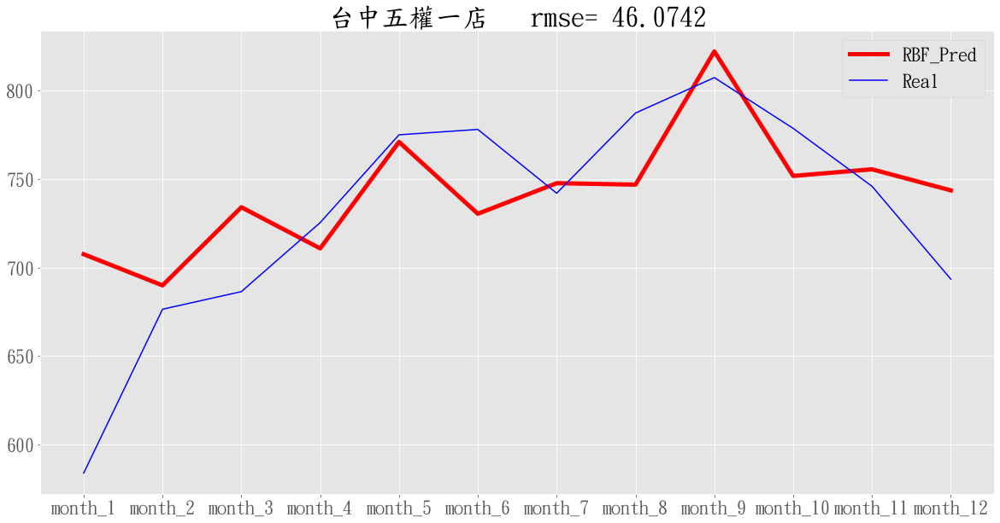

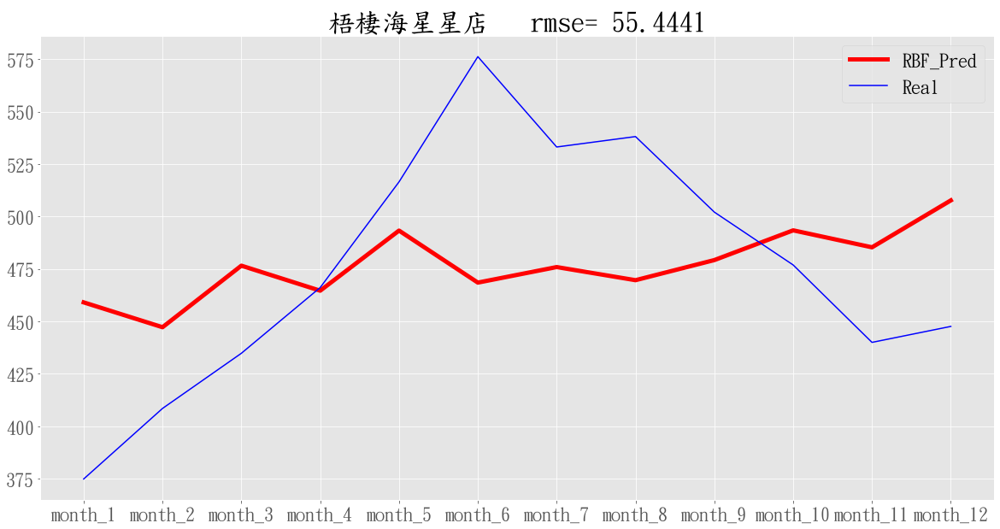

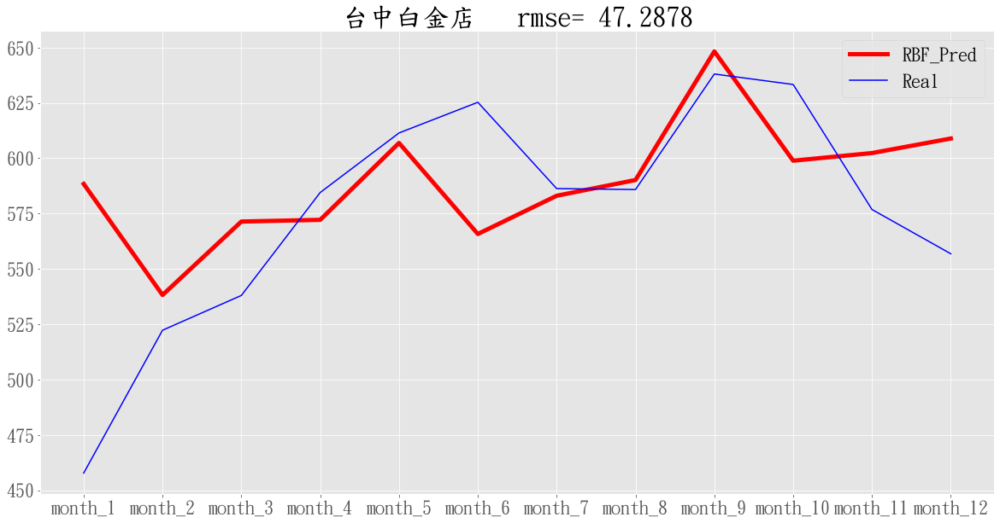

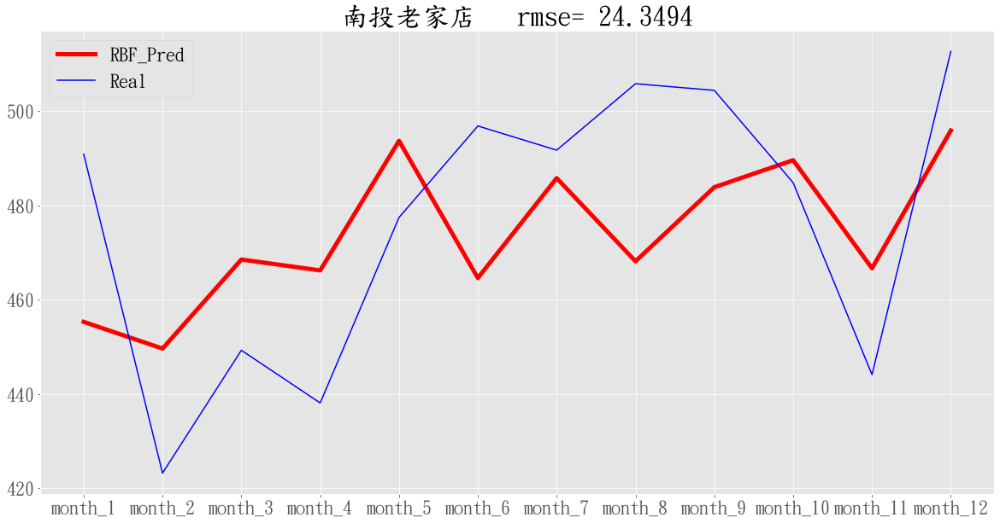

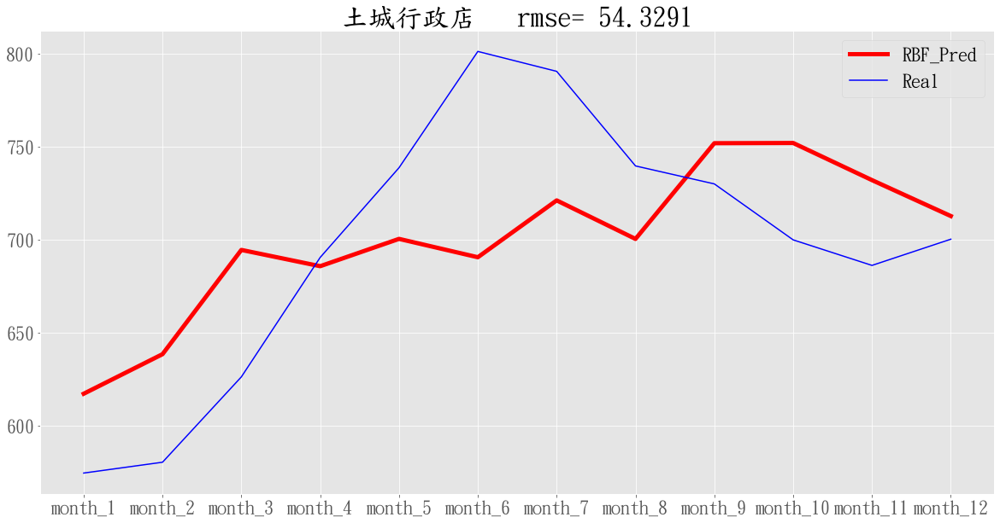

...

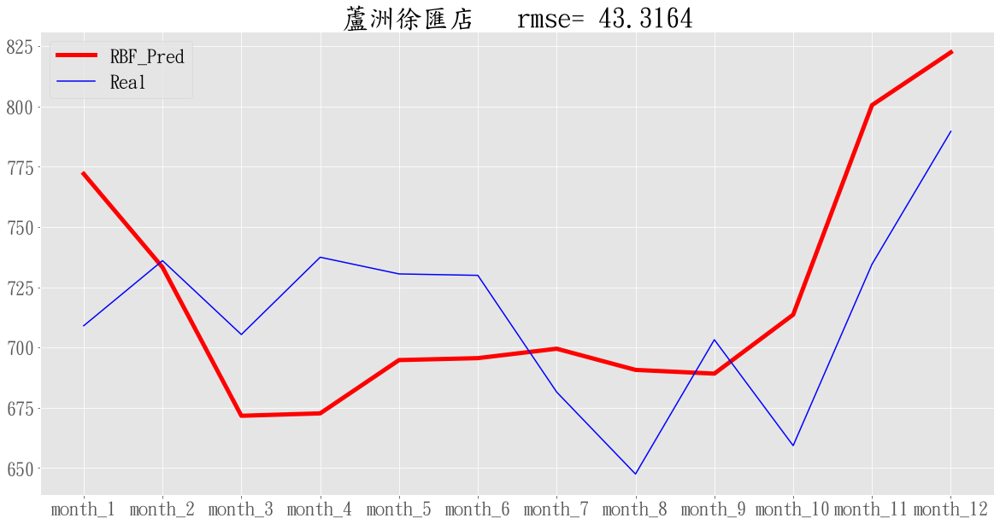

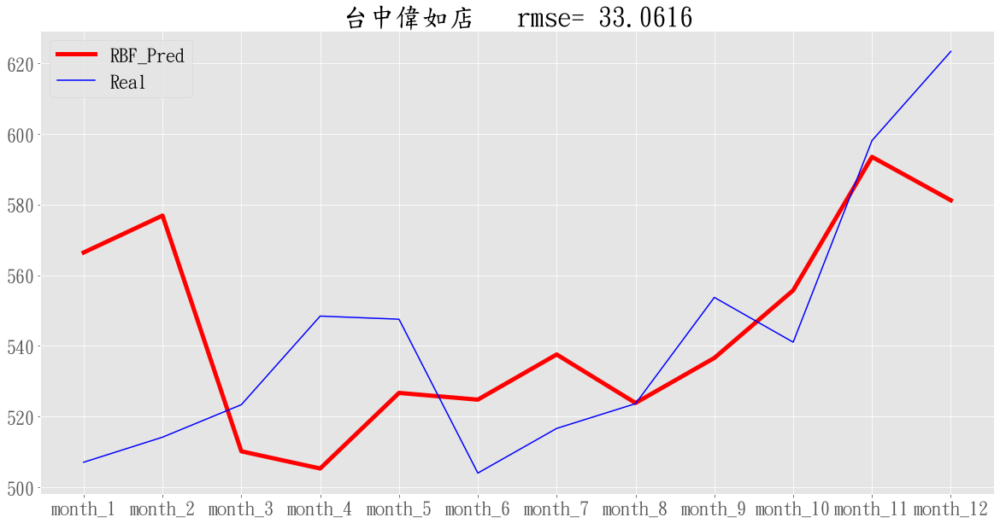

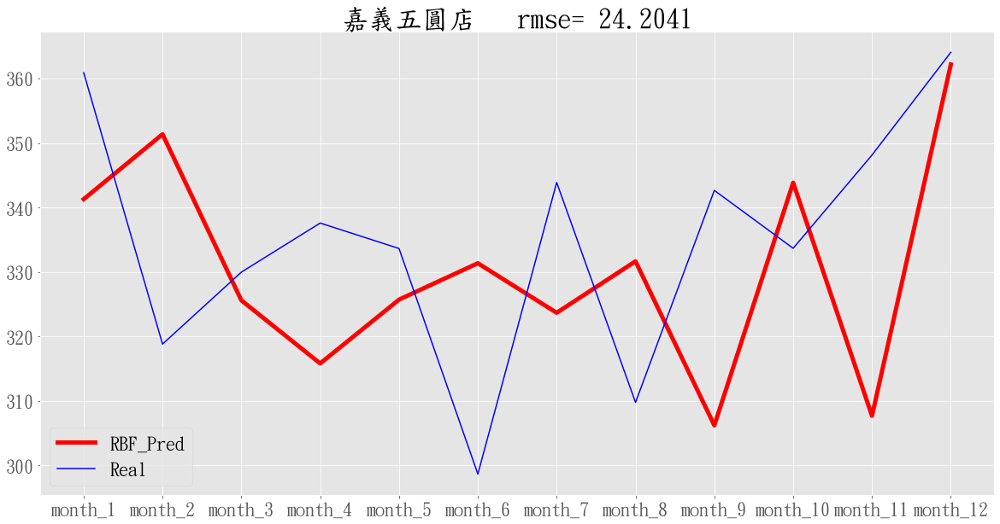

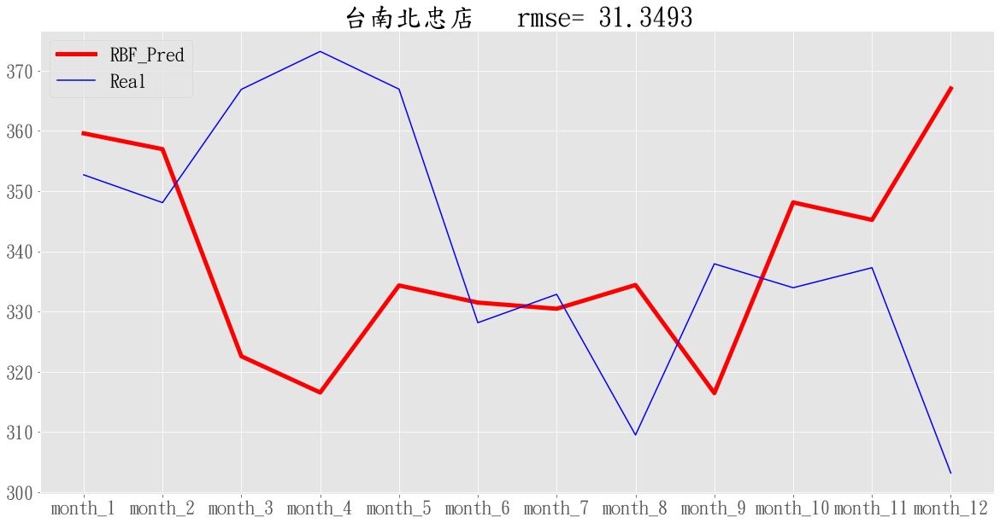

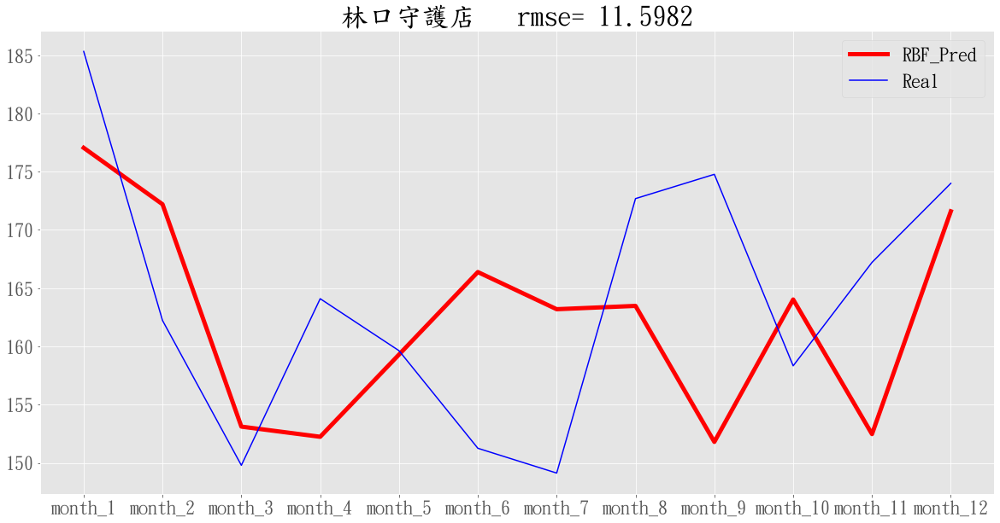

In [256]:
font = {'family' : 'DFKai-SB',
'weight' : 'bold',
'size'  : '22'}
plt.rc('font', **font)

for i in range(len(predict)):
    rmse = np.sqrt(metrics.mean_squared_error(target_108_real_df.iloc[i, 1:], predict.iloc[i, :]))
    plt.figure(figsize=(20,10))
    plt.rcParams.update({'font.size': 22})
    plt.plot(predict.iloc[i, :], "red", label = "RBF_Pred", linewidth=5)
    plt.plot(target_108_real_df.iloc[i, 1:].astype('float32'), "blue", label = "Real")
    plt.title(target_108_real_df['name'].tolist()[i] + '   rmse= ' + str(round(rmse, 4)))
    plt.legend()
    plt.savefig('./Result/Pic_RBF_FS_RBF_NN/Each_store_NN_Predict_' + target_108_real_df['name'].tolist()[i] + '.png')
    plt.show()
    plt.close()

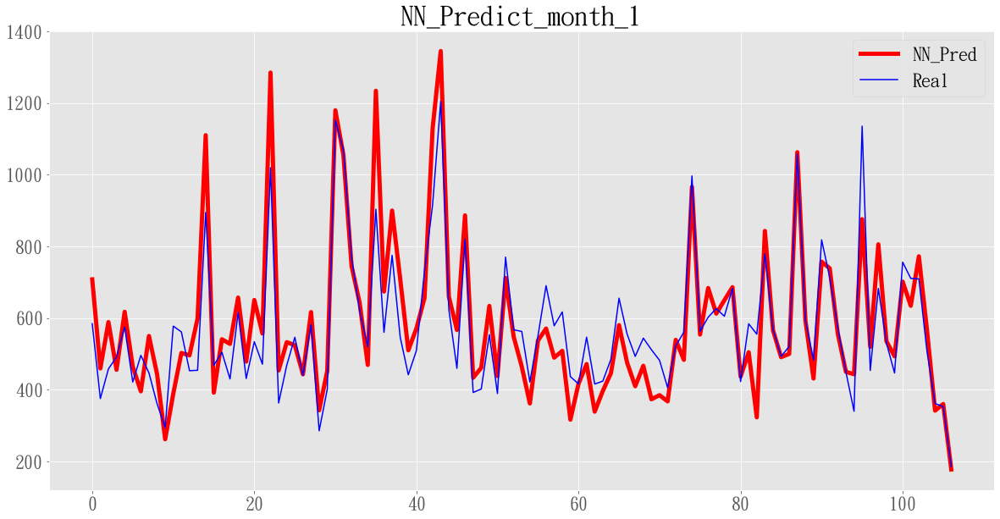

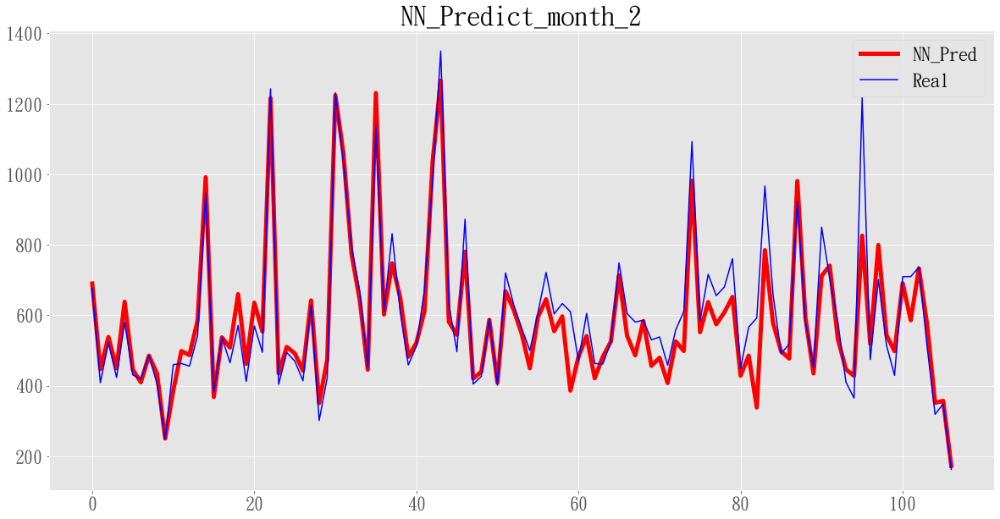

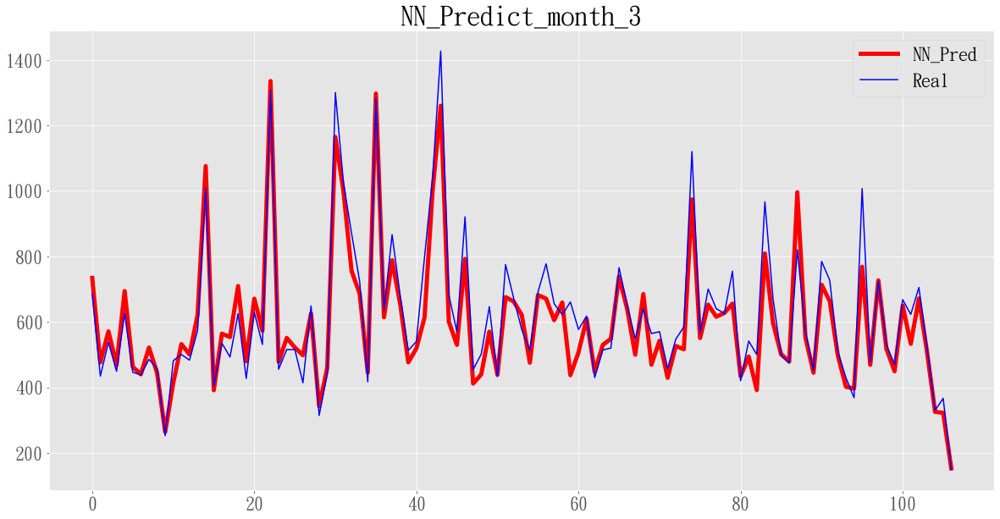

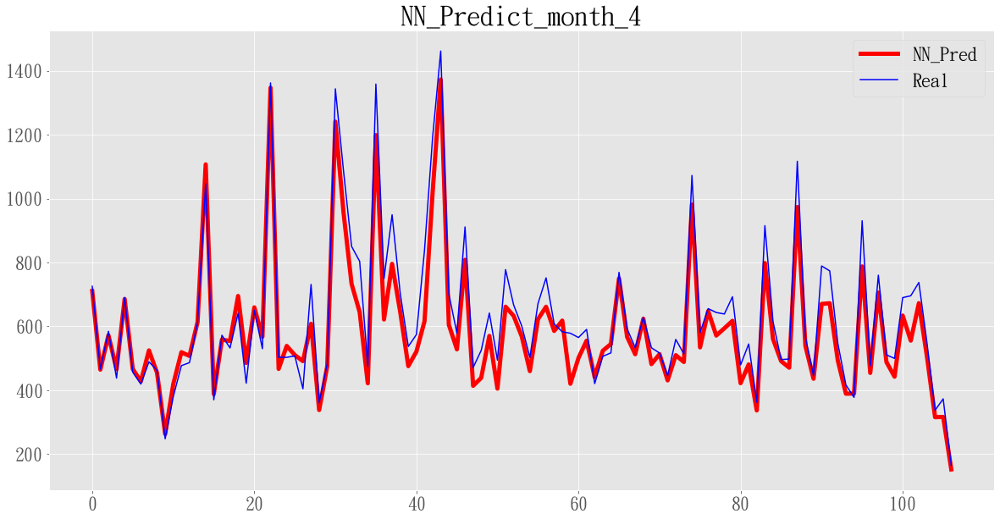

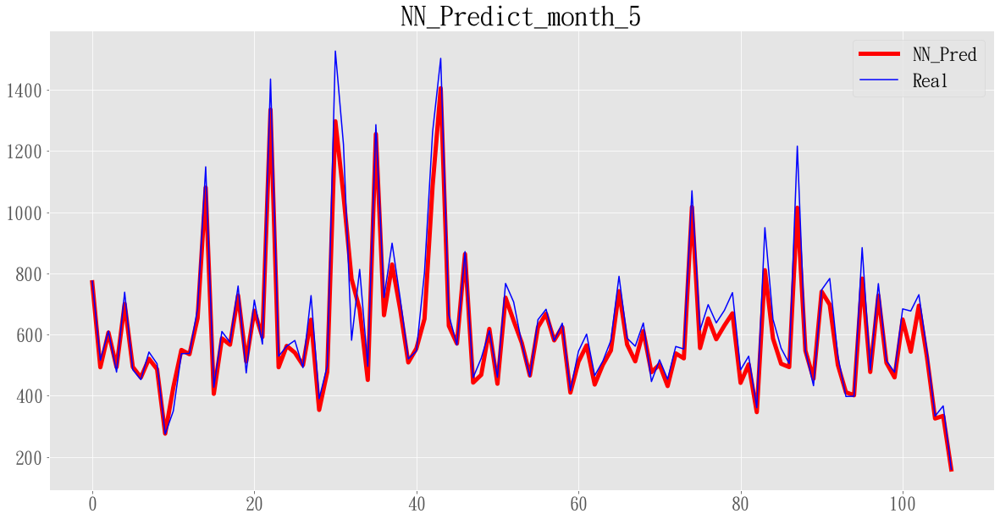

...

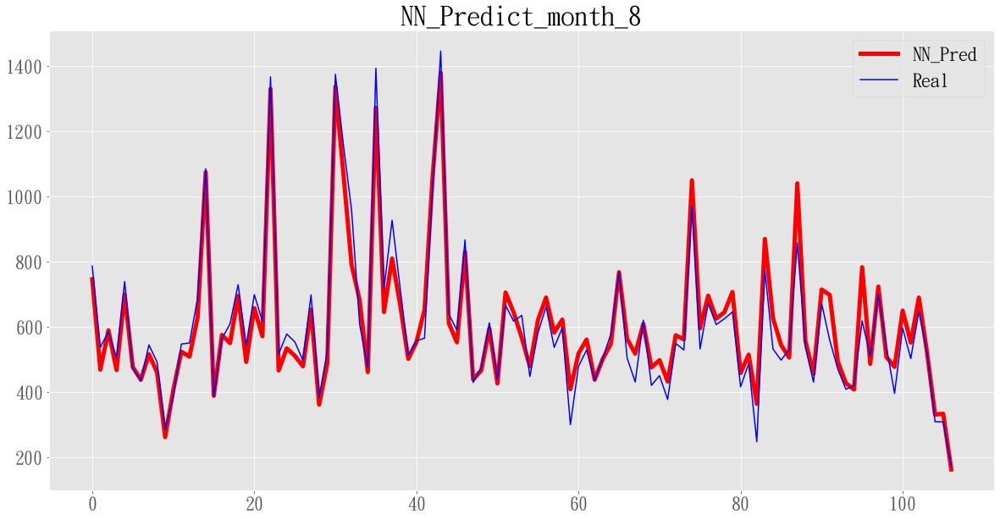

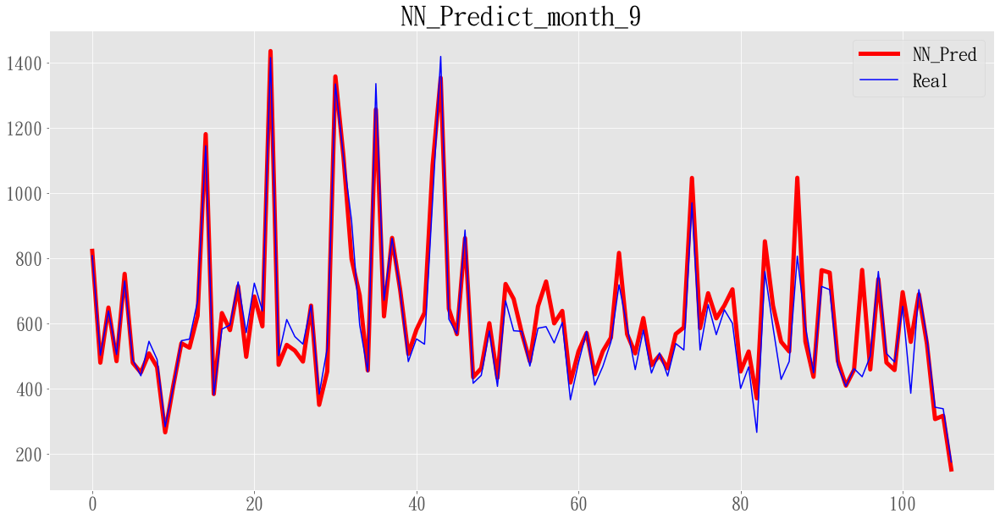

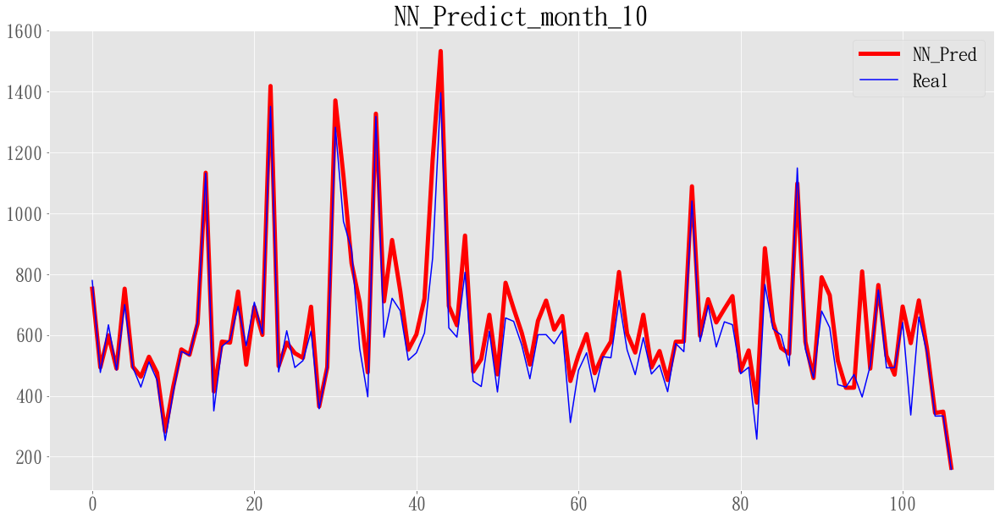

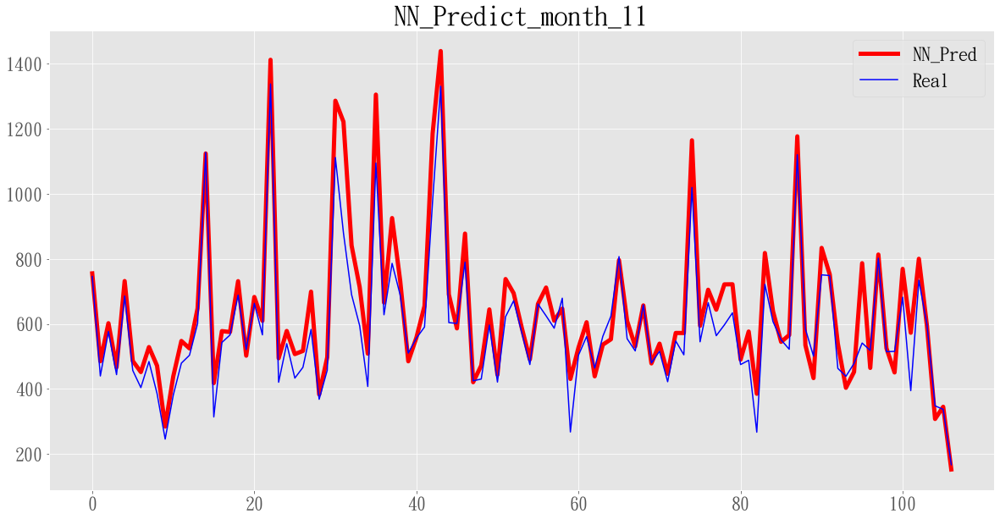

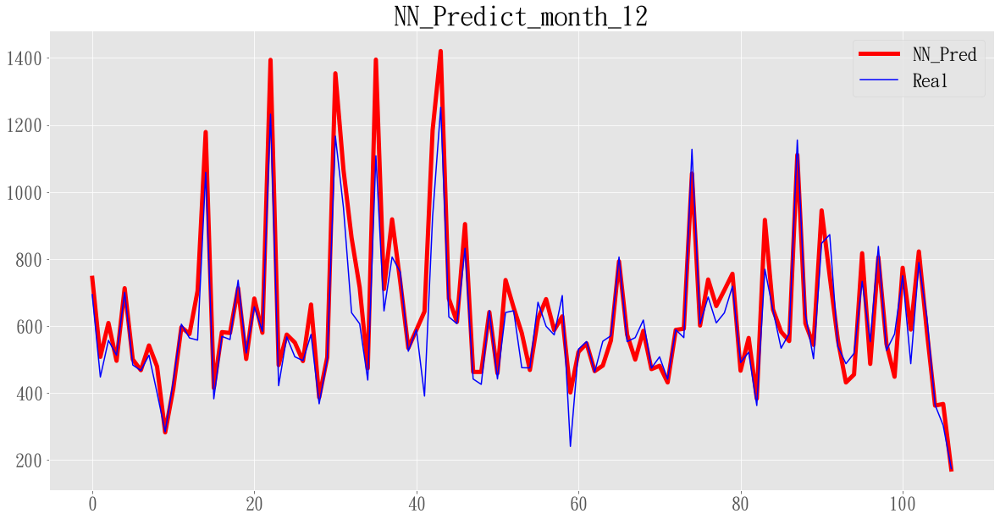

In [257]:
for name in predict.columns.tolist():
    plt.figure(figsize=(20,10))
    plt.rcParams.update({'font.size': 22})
    plt.plot(predict[name], "red", label = "NN_Pred", linewidth=5)
    plt.plot(target_108_real_df[name], "blue", label = "Real")
    plt.title("NN_Predict_" + name)
    plt.legend()
    plt.savefig('./Result/Pic_RBF_FS_RBF_NN/NN_Predict_Each_Month_' + name + '.jpg')
    plt.show()
    plt.close()

In [240]:
rm = []
rm.append()

In [242]:
pd.DataFrame([np.sqrt(metrics.mean_squared_error(target_108_real_df.iloc[:, 1:], predict.iloc[:, :-1]))])

,0
0,77.541355


In [247]:
pd.DataFrame(np.asarray(important_feature[0]).T, columns=[])

,0
0,住戶數
1,戶口數_200
2,主要客群_200
3,7-11店鋪數_100
4,工作_佔比


In [249]:
np.asarray(important_feature[0])

array(['住戶數', '戶口數_200', '主要客群_200', '7-11店鋪數_100', '工作_佔比'], dtype='<U11')